## Author: Akash

### SVI-based Variables & Indices (Boston) 

#### Loading necessary libraries

In [ ]:
# Import libraries
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import geopandas as gpd
import pandas as pd
import numpy as np
from functools import reduce
import contextily as ctx
import datetime as dt
import math
import plotly.express as px
from scipy.stats import spearmanr

#Importing spatial libraries
import rtree
import fiona.crs
from libpysal.weights.contiguity import Queen
from libpysal import examples
from libpysal import weights
import esda
from esda.moran import Moran, Moran_Local,Moran_BV, Moran_Local_BV
from splot.esda import lisa_cluster, plot_moran_bv_simulation, plot_moran_bv, plot_local_autocorrelation, moran_scatterplot

/home/jovyan/venv/lib/python3.7/site-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


#### Loading Datasets

In [ ]:
# Read ACS data
df_full = pd.read_csv('/work/COVIDRedlining/data/ACS/ACS Census Tract 2018 (5 years).csv')
df_full.head()

,geo_id,city_name,redline_index,do_date,total_pop,households,male_pop,female_pop,median_age,male_under_5,...,in_grades_9_to_12,in_school,in_undergrad_college,speak_only_english_at_home,speak_spanish_at_home,speak_spanish_at_home_low_english,aged_65_or_older,aged_17_or_younger,multi_unit_structures,non_white
0,6.037550e+09,Los Angeles,75,2014-01-01,8192,2318,4069,4123,38.8,342,...,527,1974,390,NaN,NaN,NaN,1000,1915,526,6749
1,6.037551e+09,Los Angeles,50,2014-01-01,7311,2208,3596,3715,40.0,201,...,434,1836,363,NaN,NaN,NaN,1226,1686,564,5866
2,6.037603e+09,Los Angeles,100,2014-01-01,3742,1334,1864,1878,41.7,78,...,168,681,99,NaN,NaN,NaN,762,714,797,3369
3,6.037603e+09,Los Angeles,100,2014-01-01,3846,1469,1846,2000,45.2,166,...,126,776,299,NaN,NaN,NaN,750,635,750,3485
4,6.037603e+09,Los Angeles,100,2014-01-01,3908,1572,1725,2183,43.2,79,...,173,1002,380,NaN,NaN,NaN,768,611,554,3468


#### Filtering for Boston

In [ ]:
df = df_full[df_full['city_name'] == 'Boston']

In [ ]:
#Loading redlining data for Boston
df_redline = gpd.read_file('/work/COVIDRedlining/data/boston/boston_redlined_numerical_values.geojson')

Subsetting redlining data to only include geo id's, the reweighted redlining index and the ordinal redlining index value

In [ ]:
df_redline = df_redline[['GEOID','reweighted_redline_index', 'ordinal_value']]

In [ ]:
#Renaming GEOID for merging
df_redline.rename(columns = {'GEOID':'geo_id'}, inplace=True)

In [ ]:
#Merging Boston ACS data with redlining data
df = pd.merge(df,
                 df_redline,
                 on='geo_id', 
                 how='left')

In [ ]:
df.columns.tolist()

['geo_id',
 'city_name',
 'redline_index',
 'do_date',
 'total_pop',
 'households',
 'male_pop',
 'female_pop',
 'median_age',
 'male_under_5',
 'male_5_to_9',
 'male_10_to_14',
 'male_15_to_17',
 'male_18_to_19',
 'male_20',
 'male_21',
 'male_22_to_24',
 'male_25_to_29',
 'male_30_to_34',
 'male_35_to_39',
 'male_40_to_44',
 'male_45_to_49',
 'male_50_to_54',
 'male_55_to_59',
 'male_60_to_61',
 'male_62_to_64',
 'male_65_to_66',
 'male_67_to_69',
 'male_70_to_74',
 'male_75_to_79',
 'male_80_to_84',
 'male_85_and_over',
 'female_under_5',
 'female_5_to_9',
 'female_10_to_14',
 'female_15_to_17',
 'female_18_to_19',
 'female_20',
 'female_21',
 'female_22_to_24',
 'female_25_to_29',
 'female_30_to_34',
 'female_35_to_39',
 'female_40_to_44',
 'female_45_to_49',
 'female_50_to_54',
 'female_55_to_59',
 'female_60_to_61',
 'female_62_to_64',
 'female_65_to_66',
 'female_67_to_69',
 'female_70_to_74',
 'female_75_to_79',
 'female_80_to_84',
 'female_85_and_over',
 'white_pop',
 'populat

#### Creating variables for SVI index across 4 themes

In [ ]:
# Create 4 new SVI variables from ACS variables 
df['aged_65_or_older'] = df['female_65_to_66'] + df['female_67_to_69'] + df['female_70_to_74'] + df['female_75_to_79'] + df['female_80_to_84'] + df['female_85_and_over'] + df['male_65_to_66'] + df['male_67_to_69'] + df['male_70_to_74'] + df['male_75_to_79'] + df['male_80_to_84'] + df['male_85_and_over']
df['aged_17_or_younger'] = df['female_under_5'] + df['female_5_to_9'] + df['female_10_to_14'] + df['female_15_to_17'] + df['male_under_5'] + df['male_5_to_9'] + df['male_10_to_14'] + df['male_15_to_17']
df['multi_unit_structures'] = df['dwellings_10_to_19_units'] + df['dwellings_20_to_49_units'] + df['dwellings_50_or_more_units']

# Non-white
df['non_white'] = df['total_pop'] - df['white_pop']

In [ ]:
def perc_bin(x):
    
    if x > 0 and x <= 0.1:
      val = 1
    elif x > 0.1 and x <= 0.2:
      val = 2
    elif x > 0.2 and x <= 0.3:
      val = 3
    elif x > 0.3 and x <= 0.4:
      val = 4
    elif x > 0.4 and x <= 0.5:
      val = 5
    elif x > 0.5 and x <= 0.6:
      val = 6
    elif x > 0.6 and x <= 0.7:
      val = 7
    elif x > 0.7 and x <= 0.8:
      val = 8
    elif x > 0.8 and x <= 0.9:
      val = 9
    elif x > 0.9 and x <= 1:
      val = 10
    else:
      val = 0

    return val

In [ ]:
# Define a set variables selected based on SVI, for the purpose of data cleaning
SVI_Vars = ['geo_id','poverty','unemployed_pop','median_income','income_per_capita','less_than_high_school_graduate',
'aged_65_or_older','aged_17_or_younger','one_parent_families_with_young_children',
'non_white','multi_unit_structures','mobile_homes','no_cars','group_quarters',
'pop_determined_poverty_status','total_pop','households','housing_units', 'reweighted_redline_index','ordinal_value']

In [ ]:
#Preserve Boston Geodataframe
gdf_Boston = df.copy()
gdf_Boston.head()

,geo_id,city_name,redline_index,do_date,total_pop,households,male_pop,female_pop,median_age,male_under_5,...,in_undergrad_college,speak_only_english_at_home,speak_spanish_at_home,speak_spanish_at_home_low_english,aged_65_or_older,aged_17_or_younger,multi_unit_structures,non_white,reweighted_redline_index,ordinal_value
0,2.502506e+10,Boston,100,2014-01-01,4071,2005,2173,1898,31.4,135,...,86,NaN,NaN,NaN,196,476,233,351,3.792748,4
1,2.502506e+10,Boston,100,2014-01-01,2300,1094,914,1386,29.4,68,...,127,NaN,NaN,NaN,173,751,249,1892,3.996286,4
2,2.502507e+10,Boston,100,2014-01-01,7075,3493,3534,3541,31.7,158,...,1376,NaN,NaN,NaN,819,536,4257,3359,4.000000,4
3,2.502507e+10,Boston,100,2014-01-01,2398,1136,1157,1241,39.4,0,...,242,NaN,NaN,NaN,465,230,922,1683,4.000000,4
4,2.502507e+10,Boston,100,2014-01-01,4290,2185,2095,2195,37.0,94,...,49,NaN,NaN,NaN,485,489,1323,2238,4.000000,4


In [ ]:
#Subsetting SVI variables
gdf_Boston = gdf_Boston[SVI_Vars]
gdf_Boston.head()

,geo_id,poverty,unemployed_pop,median_income,income_per_capita,less_than_high_school_graduate,aged_65_or_older,aged_17_or_younger,one_parent_families_with_young_children,non_white,multi_unit_structures,mobile_homes,no_cars,group_quarters,pop_determined_poverty_status,total_pop,households,housing_units,reweighted_redline_index,ordinal_value
0,2.502506e+10,135.0,101.0,132750.0,80548.0,90.0,196,476,0.0,351,233,0,394.0,0,4071.0,4071,2005,2154,3.792748,4
1,2.502506e+10,1304.0,212.0,12759.0,11501.0,473.0,173,751,218.0,1892,249,0,684.0,0,2300.0,2300,1094,1164,3.996286,4
2,2.502507e+10,1292.0,309.0,84083.0,85562.0,656.0,819,536,0.0,3359,4257,0,2040.0,1175,6037.0,7075,3493,4585,4.000000,4
3,2.502507e+10,752.0,96.0,28851.0,35524.0,482.0,465,230,12.0,1683,922,0,535.0,113,2303.0,2398,1136,1273,4.000000,4
4,2.502507e+10,1150.0,151.0,52676.0,53710.0,415.0,485,489,97.0,2238,1323,11,973.0,351,4199.0,4290,2185,2272,4.000000,4


In [ ]:
# Remove duplicates and null values from the SVI-based variables dataset before further processing
gdf_Boston.drop_duplicates(inplace=True)
gdf_Boston.dropna(inplace=True)

In [ ]:
#Merging with geo file for spatial analysis

import geopandas as gpd
#Loading MASS geofile
boston_geodf = gpd.read_file('/work/COVIDRedlining/data/boston/boston census tracts/tl_2019_25_tract.shp')

#Taking only geo-values for boston
boston_geoid = list(df_redline['geo_id'])

#Renaming columns 
boston_geodf = boston_geodf.rename(columns={'GEOID':'geo_id'})

#Converting data types
boston_geodf['geo_id'] = boston_geodf['geo_id'].astype(float) 

#Subsetting only boston valyes
boston_geodf = boston_geodf.loc[boston_geodf['geo_id'].isin(boston_geoid)]

#Merging SVI with geo df 
gdf_Boston = boston_geodf.merge(gdf_Boston, on ='geo_id', how ='left')
gdf_Boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,multi_unit_structures,mobile_homes,no_cars,group_quarters,pop_determined_poverty_status,total_pop,households,housing_units,reweighted_redline_index,ordinal_value
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,2482.0,0.0,1102.0,0.0,3145.0,3145.0,2008.0,2693.0,3.904488,4.0
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,120.0,0.0,317.0,0.0,2750.0,2817.0,1024.0,1056.0,3.725805,4.0
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,41.0,0.0,303.0,6.0,2559.0,2559.0,1177.0,1241.0,4.000000,4.0
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,221.0,0.0,81.0,7.0,2475.0,2475.0,929.0,995.0,3.000000,3.0
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,905.0,0.0,1242.0,18.0,5726.0,5750.0,2298.0,2377.0,3.000000,3.0


#### Creating SVI variables + indices

In [ ]:
#Making a copy of the Boston data to use for subsetting minority populations later
svi_boston_minority = gdf_Boston.copy()

#Making a copy of the Boston data to use for creating SVI variables for all census tracts
svi_boston = gdf_Boston.copy()

#Creating SVI variables for all census tracts
svi_boston['poverty_perc'] = svi_boston['poverty']/svi_boston['pop_determined_poverty_status']
svi_boston['poverty_perc_bin'] = svi_boston['poverty_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['poverty_perc'] >= svi_boston['poverty_perc'].quantile(0.9), 'poverty_flag'] = 1
svi_boston['poverty_flag'] = svi_boston['poverty_flag'].fillna(0)

svi_boston['unemployed_pop_perc'] = svi_boston['unemployed_pop'] / svi_boston['total_pop']
svi_boston['unemployed_pop_perc_bin'] = svi_boston['unemployed_pop_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['unemployed_pop_perc'] >= svi_boston['unemployed_pop_perc'].quantile(0.9), 'unemployed_flag'] = 1
svi_boston['unemployed_flag'] = svi_boston['unemployed_flag'].fillna(0)

svi_boston['less_than_high_school_graduate_perc'] = svi_boston['less_than_high_school_graduate'] / svi_boston['total_pop']
svi_boston['less_than_high_school_graduate_perc_bin'] = svi_boston['less_than_high_school_graduate_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['less_than_high_school_graduate_perc'] >= svi_boston['less_than_high_school_graduate_perc'].quantile(0.9), 'less_than_high_school_graduate_flag'] = 1
svi_boston['less_than_high_school_graduate_flag'] = svi_boston['less_than_high_school_graduate_flag'].fillna(0)

svi_boston['aged_65_or_older_perc'] = svi_boston['aged_65_or_older'] / svi_boston['total_pop']
svi_boston['aged_65_or_older_perc_bin'] = svi_boston['aged_65_or_older_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['aged_65_or_older_perc'] >= svi_boston['aged_65_or_older_perc'].quantile(0.9), 'aged_65_or_older_flag'] = 1
svi_boston['aged_65_or_older_flag'] = svi_boston['aged_65_or_older_flag'].fillna(0)

svi_boston['aged_17_or_younger_perc'] = svi_boston['aged_17_or_younger'] / svi_boston['total_pop']
svi_boston['aged_17_or_younger_perc_bin'] = svi_boston['aged_17_or_younger_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['aged_17_or_younger_perc'] >= svi_boston['aged_17_or_younger_perc'].quantile(0.9), 'aged_17_or_younger_flag'] = 1
svi_boston['aged_17_or_younger_flag'] = svi_boston['aged_17_or_younger_flag'].fillna(0)

svi_boston['non_white_perc'] = svi_boston['non_white'] / svi_boston['total_pop']
svi_boston['non_white_perc_bin'] = svi_boston['non_white_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['non_white_perc'] >= svi_boston['non_white_perc'].quantile(0.9), 'non_white_flag'] = 1
svi_boston['non_white_flag'] = svi_boston['non_white_flag'].fillna(0)

svi_boston['one_parent_families_with_young_children_perc'] = svi_boston['one_parent_families_with_young_children'] / svi_boston['households']
svi_boston['one_parent_families_with_young_children_perc_bin'] = svi_boston['one_parent_families_with_young_children_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['one_parent_families_with_young_children_perc'] >= svi_boston['one_parent_families_with_young_children_perc'].quantile(0.9), 'one_parent_families_with_young_children_flag'] = 1
svi_boston['one_parent_families_with_young_children_flag'] = svi_boston['one_parent_families_with_young_children_flag'].fillna(0)

svi_boston['multi_unit_structures_perc'] = svi_boston['multi_unit_structures'] / svi_boston['housing_units']
svi_boston['multi_unit_structures_perc_bin'] = svi_boston['multi_unit_structures_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['multi_unit_structures_perc'] >= svi_boston['multi_unit_structures_perc'].quantile(0.9), 'multi_unit_structures_flag'] = 1
svi_boston['multi_unit_structures_flag'] = svi_boston['multi_unit_structures_flag'].fillna(0)

svi_boston['mobile_homes_perc'] = svi_boston['mobile_homes'] / svi_boston['housing_units']
svi_boston['mobile_homes_perc_bin'] = svi_boston['mobile_homes_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['mobile_homes_perc'] >= svi_boston['mobile_homes_perc'].quantile(0.9), 'mobile_homes_flag'] = 1
svi_boston['mobile_homes_flag'] = svi_boston['mobile_homes_flag'].fillna(0)

svi_boston['no_cars_perc'] = svi_boston['no_cars'] / svi_boston['households']
svi_boston['no_cars_perc_bin'] = svi_boston['no_cars_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['no_cars_perc'] >= svi_boston['no_cars_perc'].quantile(0.9), 'no_cars_flag'] = 1
svi_boston['no_cars_flag'] = svi_boston['no_cars_flag'].fillna(0)

svi_boston['group_quarters_perc'] = svi_boston['group_quarters'] / svi_boston['total_pop']
svi_boston['group_quarters_perc_bin'] = svi_boston['group_quarters_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['group_quarters_perc'] >= svi_boston['group_quarters_perc'].quantile(0.9), 'group_quarters_flag'] = 1
svi_boston['group_quarters_flag'] = svi_boston['group_quarters_flag'].fillna(0)

In [ ]:
# Setting flags for the tracts which are ranked at 90th percentile and above

svi_boston.loc[svi_boston['median_income'] <= svi_boston['median_income'].quantile(0.1), 'median_income_flag'] = 1
svi_boston['median_income_flag'] = svi_boston['median_income_flag'].fillna(0)

svi_boston.loc[svi_boston['income_per_capita'] <= svi_boston['income_per_capita'].quantile(0.1), 'income_per_capita_flag'] = 1
svi_boston['income_per_capita_flag'] = svi_boston['income_per_capita_flag'].fillna(0)

In [ ]:
# The number of flags (for each tract), all SVI-based variables
svi_boston['SVI'] = svi_boston['poverty_flag'] + svi_boston['unemployed_flag'] + svi_boston['median_income_flag'] + svi_boston['income_per_capita_flag'] + svi_boston['less_than_high_school_graduate_flag'] + svi_boston['aged_65_or_older_flag'] + svi_boston['aged_17_or_younger_flag'] + svi_boston['one_parent_families_with_young_children_flag'] + svi_boston['non_white_flag'] + svi_boston['multi_unit_structures_flag'] + svi_boston['mobile_homes_flag'] + svi_boston['no_cars_flag'] + svi_boston['group_quarters_flag']

# The number of flags (for each tract); Theme#1: Socioeconomic Status
svi_boston['SVI_1'] = svi_boston['poverty_flag'] + svi_boston['unemployed_flag'] + svi_boston['median_income_flag'] + svi_boston['income_per_capita_flag'] + svi_boston['less_than_high_school_graduate_flag']

# The number of flags (for each tract); Theme#2: Household Composition & Disability
svi_boston['SVI_2'] = svi_boston['aged_65_or_older_flag'] + svi_boston['aged_17_or_younger_flag'] + svi_boston['one_parent_families_with_young_children_flag']

# The number of flags (for each tract); Theme#3: Minority Status & Language
svi_boston['SVI_3'] = svi_boston['non_white_flag']

# The number of flags (for each tract); Theme#4: Housing Type & Transportation
svi_boston['SVI_4'] = svi_boston['multi_unit_structures_flag'] + svi_boston['mobile_homes_flag'] + svi_boston['no_cars_flag'] + svi_boston['group_quarters_flag']

In [ ]:
#### Combining with rental prioritization

rp = gpd.read_file('/work/COVIDRedlining/data/rent prioritisation/housing_index_state_adj.geojson')
rp.head()

,GEOID,state_name,county_name,state_fips,county_fips,perc_cost_burdened_under_35k,perc_overcrowding_renter_1.50_or_more,perc_unemployed_laborforce,perc_renters,perc_poverty_12mnth,...,z_score_perc_poverty_12mnth_quantile,z_score_perc_no_hinsure_quantile,z_score_perc_person_of_color_quantile,z_score_perc_public_assistance_quantile,z_score_perc_foreign_born_quantile,z_score_perc_30hamfi_quantile,z_score_perc_low_income_jobs_lost_quantile,num_ELI,grayed_out,geometry
0,01073005701,Alabama,Jefferson County,01,01073,0.691943,0.000000,0.171334,0.412351,0.194963,...,0.55,0.23,0.96,0.01,0.33,0.47,0.93,100.0,0.0,"MULTIPOLYGON (((-86.90350 33.45676, -86.90093 ..."
1,01073010704,Alabama,Jefferson County,01,01073,0.533333,0.012195,0.063052,0.525220,0.097222,...,0.21,0.12,0.45,0.01,0.85,0.37,0.83,130.0,0.0,"MULTIPOLYGON (((-86.82052 33.45868, -86.81621 ..."
2,01073012908,Alabama,Jefferson County,01,01073,0.582278,0.000000,0.058507,0.606704,0.135747,...,0.34,0.80,0.74,0.70,0.99,0.24,0.87,185.0,0.0,"MULTIPOLYGON (((-86.80666 33.41088, -86.80642 ..."
3,01073005302,Alabama,Jefferson County,01,01073,0.386667,0.000000,0.040827,0.214047,0.087376,...,0.17,0.48,0.66,0.58,0.58,0.23,0.59,40.0,0.0,"MULTIPOLYGON (((-86.71510 33.57597, -86.70716 ..."
4,01073011107,Alabama,Jefferson County,01,01073,0.750000,0.000000,0.053528,0.078071,0.087675,...,0.17,0.13,0.21,0.63,0.40,0.29,0.64,70.0,0.0,"MULTIPOLYGON (((-86.64797 33.59205, -86.64629 ..."


In [ ]:
#Combining with rental prioritization
rp['GEOID'] = rp['GEOID'].astype(float)
rp = rp.rename(columns={'GEOID':'geo_id'})
svi_boston = svi_boston.merge(rp[['geo_id','total_index_quantile']], on='geo_id',how='left')
svi_boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,group_quarters_perc_bin,group_quarters_flag,median_income_flag,income_per_capita_flag,SVI,SVI_1,SVI_2,SVI_3,SVI_4,total_index_quantile
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,1.0,0.66
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.82
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.43
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.69
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,1,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.96


In [ ]:
svi_boston_sub = svi_boston[['geo_id','total_index_quantile','reweighted_redline_index','ordinal_value','SVI','SVI_1','SVI_2','SVI_3','SVI_4']]
svi_boston_sub = svi_boston.rename(columns={'total_index_quantile':'rental_prioritization_index','ordinal_value':'ordinal_redline_index'})
svi_boston_sub.to_csv('boston_indices_census_tracts.csv')

#### Descriptive statistics for SVI variables across all tracts (all SVI variable thresholds are >90th percentile)

In [ ]:
svi_boston[['reweighted_redline_index','SVI','SVI_1','SVI_2','SVI_3','SVI_4','poverty_perc','unemployed_pop_perc','less_than_high_school_graduate_perc','aged_65_or_older_perc','aged_17_or_younger_perc','one_parent_families_with_young_children_perc','multi_unit_structures_perc','mobile_homes_perc','no_cars_perc','group_quarters_perc','median_income','income_per_capita']].describe()

,reweighted_redline_index,SVI,SVI_1,SVI_2,SVI_3,SVI_4,poverty_perc,unemployed_pop_perc,less_than_high_school_graduate_perc,aged_65_or_older_perc,aged_17_or_younger_perc,one_parent_families_with_young_children_perc,multi_unit_structures_perc,mobile_homes_perc,no_cars_perc,group_quarters_perc,median_income,income_per_capita
count,168.000000,196.000000,196.000000,196.000000,196.000000,196.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.00000,168.000000
mean,3.325967,1.127551,0.433673,0.260204,0.086735,0.346939,0.202361,0.040965,0.090519,0.110829,0.160218,0.066303,0.308212,0.001230,0.345991,0.062164,70356.25000,44592.654762
std,0.586418,1.620084,0.977012,0.534596,0.282167,0.752460,0.128451,0.024994,0.065968,0.048948,0.086661,0.068708,0.274978,0.004018,0.176704,0.157265,34694.74621,28506.784076
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012392,0.000000,0.000000,0.001967,0.000816,0.000000,0.000000,0.000000,0.024915,0.000000,12759.00000,6868.000000
25%,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.099348,0.023688,0.036645,0.079348,0.089526,0.007411,0.099104,0.000000,0.201900,0.000882,43281.00000,23670.750000
50%,3.009528,0.000000,0.000000,0.000000,0.000000,0.000000,0.178654,0.037230,0.082451,0.109726,0.161083,0.039918,0.197825,0.000000,0.334878,0.007285,62565.00000,36567.500000
75%,4.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.282706,0.051530,0.128279,0.137788,0.224719,0.119178,0.489572,0.000000,0.472223,0.032990,95435.50000,56685.250000
max,4.000000,8.000000,5.000000,2.000000,1.000000,4.000000,0.573038,0.133786,0.295042,0.311448,0.348375,0.268792,0.983939,0.030763,0.788392,0.900909,158542.00000,153108.000000


#### Which tracts have high SVI scores across all themes? 

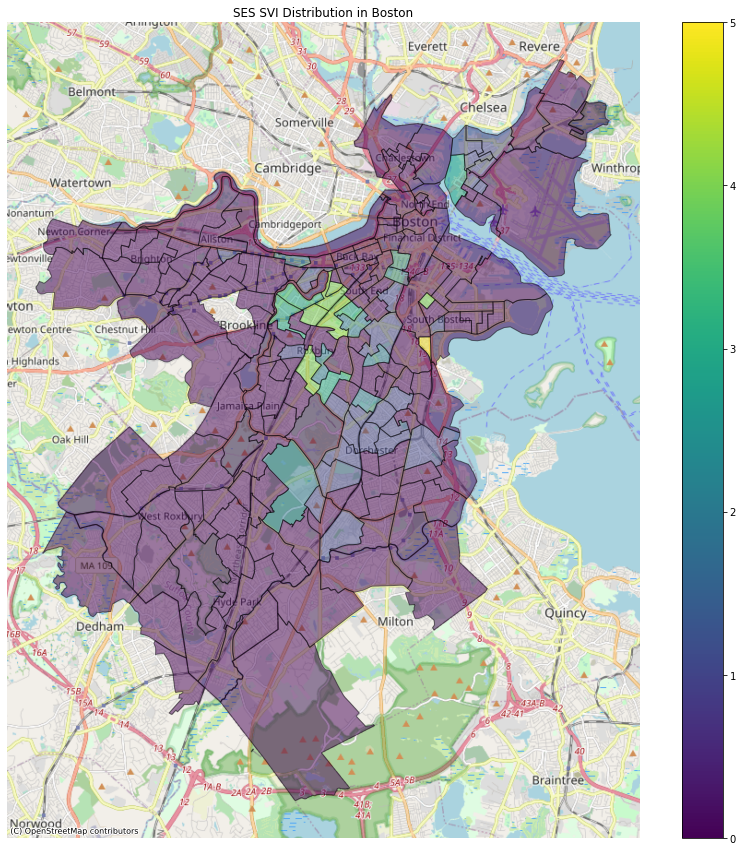

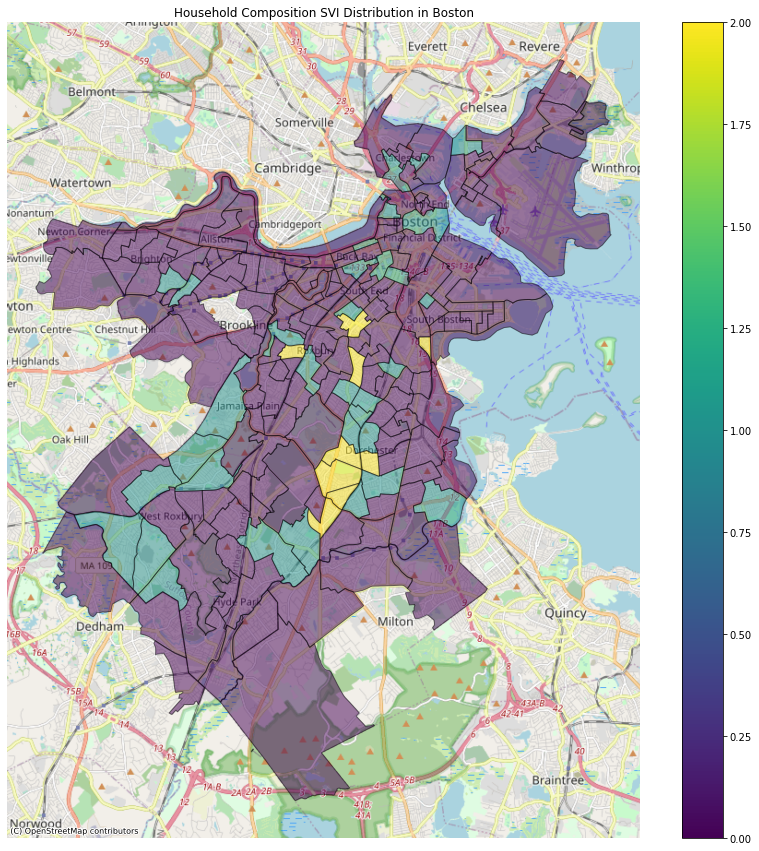

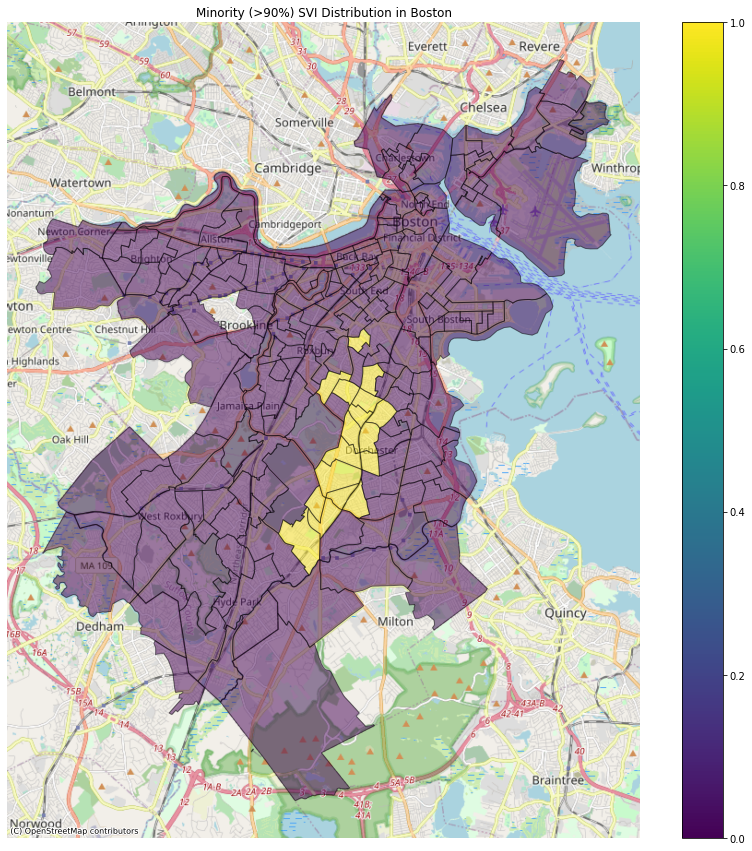

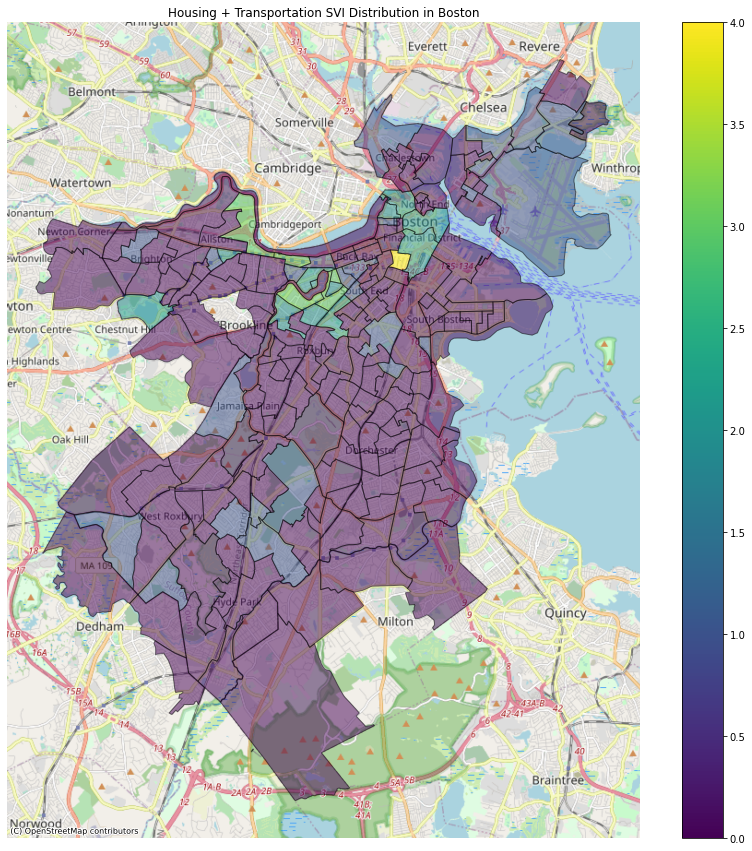

In [ ]:
#Mapping SES SVI Tracts Across Boston

svicol = ['SVI_1','SVI_2','SVI_3','SVI_4']
svinam = ['SES', 'Household Composition','Minority (>90%)', 'Housing + Transportation']

for i,j in zip(svicol,svinam): 
    ax = svi_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "viridis",legend=True)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} SVI Distribution in Boston'.format(j))
    ax.set_axis_off()

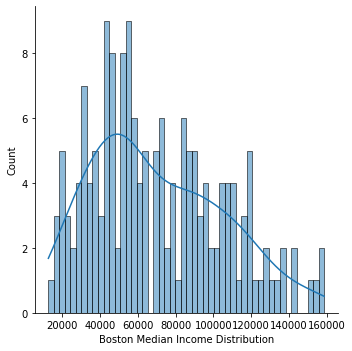

In [ ]:
#Distribution of income across Boston

ax = sns.displot(svi_boston['median_income'], bins = 50, kde = True)
ax.set_axis_labels('Boston Median Income Distribution')

#### Pivoting Minority SVI Flag with Redlining and Minority Percent Bins (for each threshold from 30 - 90%)

In [ ]:
#Merging with geo file for spatial analysis

import geopandas as gpd
#Loading MASS geofile
boston_geodf = gpd.read_file('/work/COVIDRedlining/data/boston/boston census tracts/tl_2019_25_tract.shp')

#Taking only geo-values for boston
boston_geoid = list(df_redline['geo_id'])

#Renaming columns 
boston_geodf = boston_geodf.rename(columns={'GEOID':'geo_id'})

#Converting data types
boston_geodf['geo_id'] = boston_geodf['geo_id'].astype(float) 

#Subsetting only boston valyes
boston_geodf = boston_geodf.loc[boston_geodf['geo_id'].isin(boston_geoid)]

#Merging SVI with geo df 
gdf_Boston = boston_geodf.merge(gdf_Boston[['geo_id','poverty', 'unemployed_pop', 'median_income', 'income_per_capita',
       'less_than_high_school_graduate', 'aged_65_or_older',
       'aged_17_or_younger', 'one_parent_families_with_young_children',
       'non_white', 'multi_unit_structures', 'mobile_homes', 'no_cars',
       'group_quarters', 'pop_determined_poverty_status', 'total_pop',
       'households', 'housing_units', 'reweighted_redline_index',
       'ordinal_value']], on ='geo_id', how ='left')
gdf_Boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,multi_unit_structures,mobile_homes,no_cars,group_quarters,pop_determined_poverty_status,total_pop,households,housing_units,reweighted_redline_index,ordinal_value
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,2482.0,0.0,1102.0,0.0,3145.0,3145.0,2008.0,2693.0,3.904488,4.0
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,120.0,0.0,317.0,0.0,2750.0,2817.0,1024.0,1056.0,3.725805,4.0
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,41.0,0.0,303.0,6.0,2559.0,2559.0,1177.0,1241.0,4.000000,4.0
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,221.0,0.0,81.0,7.0,2475.0,2475.0,929.0,995.0,3.000000,3.0
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,905.0,0.0,1242.0,18.0,5726.0,5750.0,2298.0,2377.0,3.000000,3.0


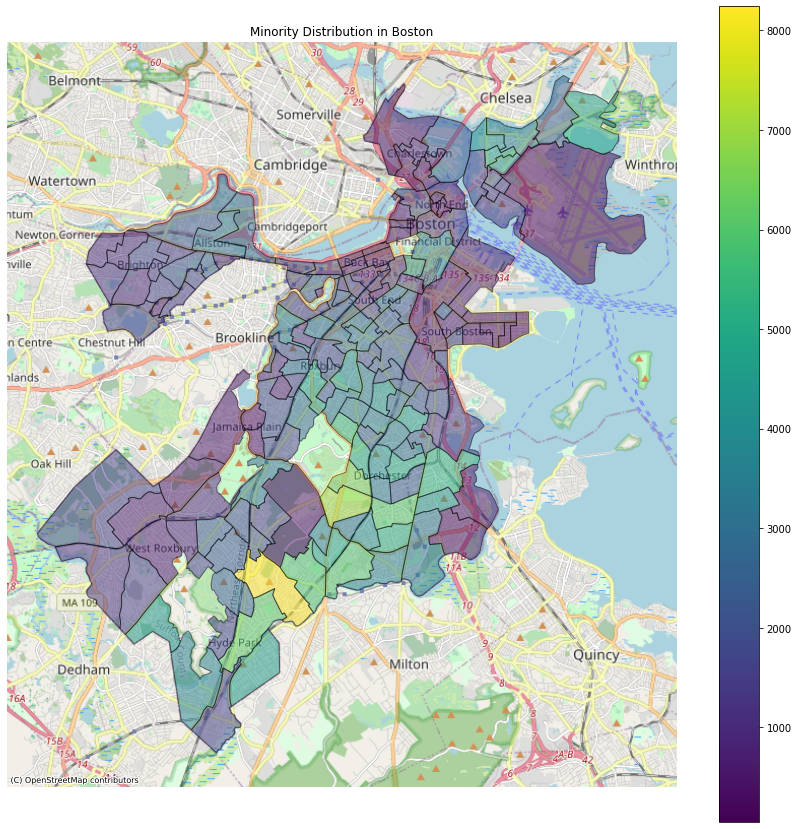

In [ ]:
#Mapping Minority Tracts Across Boston
ax = gdf_Boston.to_crs('EPSG:3857').plot(column='non_white',figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "viridis",legend=True)
ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title('Minority Distribution in Boston')
ax.set_axis_off()

In [ ]:
#Pivoting redlining values with minority thresholds

#Renaming columns 
gdf_Boston = gdf_Boston.rename(columns={'ordinal_value':'redlining_index'})

#Getting all threshold values
minority_threshold = np.arange(0.3,1,0.1)

for i in minority_threshold:

#Making non-white percentage columns
    print(i)
    pivot_Boston = gdf_Boston.copy()
    pivot_Boston = pivot_Boston.dropna()
    pivot_Boston['non_white_perc'] = pivot_Boston['non_white'] / pivot_Boston['total_pop']
    pivot_Boston['non_white_perc_bin'] = pivot_Boston['non_white_perc'].apply(perc_bin)
    pivot_Boston.loc[pivot_Boston['non_white_perc'] >= pivot_Boston['non_white_perc'].quantile(i), 'non_white_flag'] = 1
    pivot_Boston['non_white_flag'] = pivot_Boston['non_white_flag'].fillna(0)
    print('Pivot with greater than {}% minority (threshold)'.format(i*100))
    print(pivot_Boston.pivot_table(index='redlining_index', columns = 'non_white_flag', values='geo_id', aggfunc='count',margins=True))

0.3
Pivot with greater than 30.0% minority (threshold)
non_white_flag    0.0    1.0  All
redlining_index                  
1.0               1.0    NaN    1
2.0               1.0    NaN    1
3.0              23.0   48.0   71
4.0              26.0   69.0   95
All              51.0  117.0  168
0.4
Pivot with greater than 40.0% minority (threshold)
non_white_flag    0.0    1.0  All
redlining_index                  
1.0               1.0    NaN    1
2.0               1.0    NaN    1
3.0              31.0   40.0   71
4.0              34.0   61.0   95
All              67.0  101.0  168
0.5
Pivot with greater than 50.0% minority (threshold)
non_white_flag    0.0   1.0  All
redlining_index                 
1.0               1.0   NaN    1
2.0               1.0   NaN    1
3.0              36.0  35.0   71
4.0              46.0  49.0   95
All              84.0  84.0  168
0.6000000000000001
Pivot with greater than 60.00000000000001% minority (threshold)
non_white_flag     0.0   1.0  All
redlining_i

In [ ]:
#Pivoting redlining values with minority thresholds

#Getting all threshold values
minority_threshold = np.arange(0.3,1,0.1)

for i in minority_threshold:

#Making non-white percentage columns
    pivot_Boston = gdf_Boston.copy()
    pivot_Boston = pivot_Boston.dropna()
    pivot_Boston['non_white_perc'] = pivot_Boston['non_white'] / pivot_Boston['total_pop']
    pivot_Boston['non_white_perc_bin'] = pivot_Boston['non_white_perc'].apply(perc_bin)
    pivot_Boston.loc[pivot_Boston['non_white_perc'] >= pivot_Boston['non_white_perc'].quantile(i), 'non_white_flag'] = 1
    pivot_Boston['non_white_flag'] = pivot_Boston['non_white_flag'].fillna(0)
    print('Pivot with greater than {}% minority (threshold)'.format(i*100))
    print(pivot_Boston.pivot_table(index='non_white_perc_bin', columns = 'non_white_flag', values='geo_id', aggfunc='count',margins=True))

Pivot with greater than 30.0% minority (threshold)
non_white_flag       0.0    1.0  All
non_white_perc_bin                  
1                    8.0    NaN    8
2                   18.0    NaN   18
3                   20.0    NaN   20
4                    5.0   10.0   15
5                    NaN   23.0   23
6                    NaN   12.0   12
7                    NaN   17.0   17
8                    NaN   12.0   12
9                    NaN   15.0   15
10                   NaN   28.0   28
All                 51.0  117.0  168
Pivot with greater than 40.0% minority (threshold)
non_white_flag       0.0    1.0  All
non_white_perc_bin                  
1                    8.0    NaN    8
2                   18.0    NaN   18
3                   20.0    NaN   20
4                   15.0    NaN   15
5                    6.0   17.0   23
6                    NaN   12.0   12
7                    NaN   17.0   17
8                    NaN   12.0   12
9                    NaN   15.0   15
10        

###  Correlations with reweighted redlining index

#### Spearman correlations for determining minority population cut-off

In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_reweighted_redlining_mapping_spearman = pd.DataFrame(columns=['30_pct_minority','30_pct_minority_pval','40_pct_minority','40_pct_minority_pval','50_pct_minority','50_pct_minority_pval','60_pct_minority','60_pct_minority_pval','70_pct_minority','70_pct_minority_pval','80_pct_minority','80_pct_minority_pval','90_pct_minority','90_pct_minority_pval'])

#Storing values of correlation in a list
corr_list = []

#Changing data types
gdf_Boston['non_white'] = gdf_Boston['non_white'].astype(float)
gdf_Boston['reweighted_redline_index'] = gdf_Boston['reweighted_redline_index'].astype(float)

#Renaming columns 
gdf_Boston = gdf_Boston.rename(columns={'ordinal_value':'redlining_index'})

#Getting all threshold values
minority_threshold = np.arange(0.3, 1, 0.1)

for i in minority_threshold:
    
    #Making subset with dropped NA's
    corr_Boston = gdf_Boston.copy()
    corr_Boston = corr_Boston.dropna()

    #Making non-white percentage columns
    corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
    #corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
    corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(i), 'non_white_flag'] = 1
    threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
    spearman_corr =  spearmanr(threshold_subset['reweighted_redline_index'], threshold_subset['non_white_perc'])[0]
    p_val = spearmanr(threshold_subset['reweighted_redline_index'], threshold_subset['non_white_perc'])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)


df_length = len(minority_reweighted_redlining_mapping_spearman)
minority_reweighted_redlining_mapping_spearman.loc[df_length] = corr_list
minority_reweighted_redlining_mapping_spearman

,30_pct_minority,30_pct_minority_pval,40_pct_minority,40_pct_minority_pval,50_pct_minority,50_pct_minority_pval,60_pct_minority,60_pct_minority_pval,70_pct_minority,70_pct_minority_pval,80_pct_minority,80_pct_minority_pval,90_pct_minority,90_pct_minority_pval
0,-0.050619,0.58782,-0.126199,0.208561,-0.169993,0.122119,-0.244098,0.046519,-0.271894,0.053593,-0.280805,0.107688,-0.257485,0.31841


>= 70% could be the cut-off for separating minority and non-minority tracts 

#### Spatial correlations for determining minority population cut-off

In [ ]:
## Spatial Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_reweighted_redlining_mapping_spatial = pd.DataFrame(columns=['30_pct_minority','40_pct_minority','50_pct_minority','60_pct_minority','70_pct_minority','80_pct_minority','90_pct_minority'])

#Storing values of correlation in a list
corr_list = []

##### 30% Threshold

In [ ]:
#Making non-white percentage columns
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.3), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025060700.0,25025061000.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['reweighted_redline_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  warnings.warn(message)
-0.20110667820551265


##### 40% threshold

In [ ]:
#Making non-white percentage columns
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.4), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025060700.0,25025061000.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['reweighted_redline_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.2771845430349919
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
  warnings.warn(message)


##### 50% threshold

In [ ]:
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.5), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025061101.0,25025060700.0,25025061000.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['reweighted_redline_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.28129472692656604
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  warnings.warn(message)


##### 60% threshold

In [ ]:
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.6), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025061101.0,25025140106.0,25025060700.0,25025051101.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['reweighted_redline_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.3309852290136289
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  warnings.warn(message)


##### 70% threshold

In [ ]:
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.7), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025061101.0,25025140106.0,25025060700.0,25025051101.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['reweighted_redline_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.3493499179940716
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


##### 80% threshold

In [ ]:
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.8), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
#t = [25025081001.0,25025061101.0,25025130406.0,25025140106.0,25025060700.0,25025070402.0]
#threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['reweighted_redline_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.48053681022933076


##### 90% threshold

In [ ]:
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.9), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025080300.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['reweighted_redline_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.191693529423166


In [ ]:
df_length = len(minority_reweighted_redlining_mapping_spatial)
minority_reweighted_redlining_mapping_spatial.loc[df_length] = corr_list
minority_reweighted_redlining_mapping_spatial

,30_pct_minority,40_pct_minority,50_pct_minority,60_pct_minority,70_pct_minority,80_pct_minority,90_pct_minority
0,-0.201107,-0.277185,-0.281295,-0.330985,-0.34935,-0.480537,-0.191694


Spatial correlations with 60%, 70% and 80% minority are within -0.33 to -0.48 range. The correlation for >80% threshold is higher probably because of lesser number of tracts (also implies minority populations are clustered together in space)

>=70% could be a good cut off for minority populations

### Correlations with ordinal redlining index

In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_redlining_mapping_spearman = pd.DataFrame(columns=['30_pct_minority','30_pct_minority_pval','40_pct_minority','40_pct_minority_pval','50_pct_minority','50_pct_minority_pval','60_pct_minority','60_pct_minority_pval','70_pct_minority','70_pct_minority_pval','80_pct_minority','80_pct_minority_pval','90_pct_minority','90_pct_minority_pval'])

#Storing values of correlation in a list
corr_list = []

#Renaming columns 
gdf_Boston = gdf_Boston.rename(columns={'ordinal_value':'redlining_index'})

#Changing data types
gdf_Boston['non_white'] = gdf_Boston['non_white'].astype(float)
gdf_Boston['redlining_index'] = gdf_Boston['redlining_index'].astype(float)

#Getting all threshold values
minority_threshold = np.arange(0.3, 1, 0.1)

for i in minority_threshold:
    
    #Making subset with dropped NA's
    corr_Boston = gdf_Boston.copy()
    corr_Boston = corr_Boston.dropna()

    #Making non-white percentage columns
    corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
    #corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
    corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(i), 'non_white_flag'] = 1
    threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
    spearman_corr =  spearmanr(threshold_subset['redlining_index'], threshold_subset['non_white_perc'])[0]
    p_val = spearmanr(threshold_subset['redlining_index'], threshold_subset['non_white_perc'])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)


df_length = len(minority_redlining_mapping_spearman)
minority_redlining_mapping_spearman.loc[df_length] = corr_list
minority_redlining_mapping_spearman

,30_pct_minority,30_pct_minority_pval,40_pct_minority,40_pct_minority_pval,50_pct_minority,50_pct_minority_pval,60_pct_minority,60_pct_minority_pval,70_pct_minority,70_pct_minority_pval,80_pct_minority,80_pct_minority_pval,90_pct_minority,90_pct_minority_pval
0,-0.043732,0.63966,-0.12221,0.223421,-0.096103,0.38451,-0.164302,0.183977,-0.295026,0.035579,-0.270281,0.122109,-0.024398,0.925948


In [ ]:
### SPATIAL CORRELATIONS

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_redlining_mapping_spatial = pd.DataFrame(columns=['30_pct_minority','40_pct_minority','50_pct_minority','60_pct_minority','70_pct_minority','80_pct_minority','90_pct_minority'])

#Storing values of correlation in a list
corr_list = []

In [ ]:
### 30% THRESHOLD

#Making non-white percentage columns
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.3), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025060700.0,25025061000.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['redlining_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.19796931089838096
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  warnings.warn(message)


In [ ]:
### 40% THRESHOLD

#Making non-white percentage columns
corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.4), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025060700.0,25025061000.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['redlining_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.2836079749553062
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
  warnings.warn(message)


In [ ]:
### 50% THRESHOLD

corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.5), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025061101.0,25025060700.0,25025061000.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['redlining_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.22873970259359483
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  warnings.warn(message)


In [ ]:
### 60% THRESHOLD

corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.6), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025061101.0,25025140106.0,25025060700.0,25025051101.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['redlining_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
  warnings.warn(message)
-0.3338085371959614


In [ ]:
### 70% THRESHOLD

corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.7), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025061101.0,25025140106.0,25025060700.0,25025051101.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['redlining_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.364045975997109
/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


In [ ]:
### 80% THRESHOLD

corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.8), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
#t = [25025081001.0,25025061101.0,25025130406.0,25025140106.0,25025060700.0,25025070402.0]
#threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['redlining_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.5033448314981842


In [ ]:
### 90% THRESHOLD

corr_Boston = gdf_Boston.copy()
corr_Boston = corr_Boston.dropna()

#Making non-white percentage columns
corr_Boston['non_white_perc'] = corr_Boston['non_white'] / corr_Boston['total_pop']
corr_Boston['non_white_perc_bin'] = corr_Boston['non_white_perc'].apply(perc_bin)
corr_Boston.loc[corr_Boston['non_white_perc'] >= corr_Boston['non_white_perc'].quantile(0.9), 'non_white_flag'] = 1
corr_Boston['non_white_flag'] = corr_Boston['non_white_flag'].fillna(0)
threshold_subset = corr_Boston[corr_Boston['non_white_flag'] == 1]
t = [25025080300.0]
threshold_subset = threshold_subset.loc[~threshold_subset.geo_id.isin(t)]
w = Queen.from_dataframe(threshold_subset)
w.transform = 'R'
y = threshold_subset['non_white'].values
x = threshold_subset['redlining_index'].values
moran = Moran(y,w)
moran_loc = Moran_Local(y, w)
moran_bv = Moran_BV(y, x, w)
moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
corr_list.append(moran_bv.I)
print(moran_bv.I)

-0.18928716376218768


In [ ]:
df_length = len(minority_redlining_mapping_spatial)
minority_redlining_mapping_spatial.loc[df_length] = corr_list
minority_redlining_mapping_spatial

,30_pct_minority,40_pct_minority,50_pct_minority,60_pct_minority,70_pct_minority,80_pct_minority,90_pct_minority
0,-0.197969,-0.283608,-0.22874,-0.333809,-0.364046,-0.503345,-0.189287


### SVI + Spatial Correlations with minority threshold cutoffs

In [ ]:
gdf_Boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,multi_unit_structures,mobile_homes,no_cars,group_quarters,pop_determined_poverty_status,total_pop,households,housing_units,reweighted_redline_index,ordinal_value
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,2482.0,0.0,1102.0,0.0,3145.0,3145.0,2008.0,2693.0,3.904488,4.0
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,120.0,0.0,317.0,0.0,2750.0,2817.0,1024.0,1056.0,3.725805,4.0
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,41.0,0.0,303.0,6.0,2559.0,2559.0,1177.0,1241.0,4.000000,4.0
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,221.0,0.0,81.0,7.0,2475.0,2475.0,929.0,995.0,3.000000,3.0
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,905.0,0.0,1242.0,18.0,5726.0,5750.0,2298.0,2377.0,3.000000,3.0


In [ ]:
## Separating tracts with greater than 70% minority population

svi_boston = gdf_Boston.copy()

#Creating SVI variables for all census tracts
svi_boston['poverty_perc'] = svi_boston['poverty']/svi_boston['pop_determined_poverty_status']
svi_boston['poverty_perc_bin'] = svi_boston['poverty_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['poverty_perc'] >= svi_boston['poverty_perc'].quantile(0.9), 'poverty_flag'] = 1
svi_boston['poverty_flag'] = svi_boston['poverty_flag'].fillna(0)

svi_boston['unemployed_pop_perc'] = svi_boston['unemployed_pop'] / svi_boston['total_pop']
svi_boston['unemployed_pop_perc_bin'] = svi_boston['unemployed_pop_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['unemployed_pop_perc'] >= svi_boston['unemployed_pop_perc'].quantile(0.9), 'unemployed_flag'] = 1
svi_boston['unemployed_flag'] = svi_boston['unemployed_flag'].fillna(0)

svi_boston['less_than_high_school_graduate_perc'] = svi_boston['less_than_high_school_graduate'] / svi_boston['total_pop']
svi_boston['less_than_high_school_graduate_perc_bin'] = svi_boston['less_than_high_school_graduate_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['less_than_high_school_graduate_perc'] >= svi_boston['less_than_high_school_graduate_perc'].quantile(0.9), 'less_than_high_school_graduate_flag'] = 1
svi_boston['less_than_high_school_graduate_flag'] = svi_boston['less_than_high_school_graduate_flag'].fillna(0)

svi_boston['aged_65_or_older_perc'] = svi_boston['aged_65_or_older'] / svi_boston['total_pop']
svi_boston['aged_65_or_older_perc_bin'] = svi_boston['aged_65_or_older_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['aged_65_or_older_perc'] >= svi_boston['aged_65_or_older_perc'].quantile(0.9), 'aged_65_or_older_flag'] = 1
svi_boston['aged_65_or_older_flag'] = svi_boston['aged_65_or_older_flag'].fillna(0)

svi_boston['aged_17_or_younger_perc'] = svi_boston['aged_17_or_younger'] / svi_boston['total_pop']
svi_boston['aged_17_or_younger_perc_bin'] = svi_boston['aged_17_or_younger_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['aged_17_or_younger_perc'] >= svi_boston['aged_17_or_younger_perc'].quantile(0.9), 'aged_17_or_younger_flag'] = 1
svi_boston['aged_17_or_younger_flag'] = svi_boston['aged_17_or_younger_flag'].fillna(0)

svi_boston['one_parent_families_with_young_children_perc'] = svi_boston['one_parent_families_with_young_children'] / svi_boston['households']
svi_boston['one_parent_families_with_young_children_perc_bin'] = svi_boston['one_parent_families_with_young_children_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['one_parent_families_with_young_children_perc'] >= svi_boston['one_parent_families_with_young_children_perc'].quantile(0.9), 'one_parent_families_with_young_children_flag'] = 1
svi_boston['one_parent_families_with_young_children_flag'] = svi_boston['one_parent_families_with_young_children_flag'].fillna(0)

svi_boston['multi_unit_structures_perc'] = svi_boston['multi_unit_structures'] / svi_boston['housing_units']
svi_boston['multi_unit_structures_perc_bin'] = svi_boston['multi_unit_structures_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['multi_unit_structures_perc'] >= svi_boston['multi_unit_structures_perc'].quantile(0.9), 'multi_unit_structures_flag'] = 1
svi_boston['multi_unit_structures_flag'] = svi_boston['multi_unit_structures_flag'].fillna(0)

svi_boston['mobile_homes_perc'] = svi_boston['mobile_homes'] / svi_boston['housing_units']
svi_boston['mobile_homes_perc_bin'] = svi_boston['mobile_homes_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['mobile_homes_perc'] >= svi_boston['mobile_homes_perc'].quantile(0.9), 'mobile_homes_flag'] = 1
svi_boston['mobile_homes_flag'] = svi_boston['mobile_homes_flag'].fillna(0)

svi_boston['no_cars_perc'] = svi_boston['no_cars'] / svi_boston['households']
svi_boston['no_cars_perc_bin'] = svi_boston['no_cars_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['no_cars_perc'] >= svi_boston['no_cars_perc'].quantile(0.9), 'no_cars_flag'] = 1
svi_boston['no_cars_flag'] = svi_boston['no_cars_flag'].fillna(0)

svi_boston['group_quarters_perc'] = svi_boston['group_quarters'] / svi_boston['total_pop']
svi_boston['group_quarters_perc_bin'] = svi_boston['group_quarters_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['group_quarters_perc'] >= svi_boston['group_quarters_perc'].quantile(0.9), 'group_quarters_flag'] = 1
svi_boston['group_quarters_flag'] = svi_boston['group_quarters_flag'].fillna(0)

In [ ]:
# Setting flags for the tracts which are ranked at 90th percentile and above

svi_boston.loc[svi_boston['median_income'] <= svi_boston['median_income'].quantile(0.1), 'median_income_flag'] = 1
svi_boston['median_income_flag'] = svi_boston['median_income_flag'].fillna(0)

svi_boston.loc[svi_boston['income_per_capita'] <= svi_boston['income_per_capita'].quantile(0.1), 'income_per_capita_flag'] = 1
svi_boston['income_per_capita_flag'] = svi_boston['income_per_capita_flag'].fillna(0)

In [ ]:
#Minority Flag
svi_boston['non_white_perc'] = svi_boston['non_white'] / svi_boston['total_pop']
svi_boston['non_white_perc_bin'] = svi_boston['non_white_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['non_white_perc'] >= svi_boston['non_white_perc'].quantile(0.7), 'non_white_flag'] = 1
svi_boston['non_white_flag'] = svi_boston['non_white_flag'].fillna(0)


# The number of flags (for each tract), all SVI-based variables
svi_boston['SVI'] = svi_boston['poverty_flag'] + svi_boston['unemployed_flag'] + svi_boston['median_income_flag'] + svi_boston['income_per_capita_flag'] + svi_boston['less_than_high_school_graduate_flag'] + svi_boston['aged_65_or_older_flag'] + svi_boston['aged_17_or_younger_flag'] + svi_boston['one_parent_families_with_young_children_flag'] + svi_boston['non_white_flag'] + svi_boston['multi_unit_structures_flag'] + svi_boston['mobile_homes_flag'] + svi_boston['no_cars_flag'] + svi_boston['group_quarters_flag']

# The number of flags (for each tract); Theme#1: Socioeconomic Status
svi_boston['SVI_1'] = svi_boston['poverty_flag'] + svi_boston['unemployed_flag'] + svi_boston['median_income_flag'] + svi_boston['income_per_capita_flag'] + svi_boston['less_than_high_school_graduate_flag']

# The number of flags (for each tract); Theme#2: Household Composition & Disability
svi_boston['SVI_2'] = svi_boston['aged_65_or_older_flag'] + svi_boston['aged_17_or_younger_flag'] + svi_boston['one_parent_families_with_young_children_flag']

# The number of flags (for each tract); Theme#3: Minority Status & Language
svi_boston['SVI_3'] = svi_boston['non_white_flag']

# The number of flags (for each tract); Theme#4: Housing Type & Transportation
svi_boston['SVI_4'] = svi_boston['multi_unit_structures_flag'] + svi_boston['mobile_homes_flag'] + svi_boston['no_cars_flag'] + svi_boston['group_quarters_flag']

In [ ]:
## Separating tracts with greater than 70% minority population
minority_svi_boston = svi_boston[svi_boston['non_white_flag'] == 1]

### Descriptive statistics for SVI variables where minority threshold defined as >70%

In [ ]:
minority_svi_boston[['reweighted_redline_index','SVI','SVI_1','SVI_2','SVI_3','SVI_4','poverty_perc','unemployed_pop_perc','less_than_high_school_graduate_perc','aged_65_or_older_perc','aged_17_or_younger_perc','one_parent_families_with_young_children_perc','multi_unit_structures_perc','mobile_homes_perc','no_cars_perc','group_quarters_perc','median_income','income_per_capita']].describe()

,reweighted_redline_index,SVI,SVI_1,SVI_2,SVI_3,SVI_4,poverty_perc,unemployed_pop_perc,less_than_high_school_graduate_perc,aged_65_or_older_perc,aged_17_or_younger_perc,one_parent_families_with_young_children_perc,multi_unit_structures_perc,mobile_homes_perc,no_cars_perc,group_quarters_perc,median_income,income_per_capita
count,51.000000,51.000000,51.000000,51.000000,51.0,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000
mean,3.382783,2.745098,0.960784,0.627451,1.0,0.156863,0.271567,0.055968,0.153385,0.103528,0.250377,0.143688,0.161637,0.001420,0.366566,0.024226,41647.941176,22162.862745
std,0.488169,1.547167,1.165518,0.773583,0.0,0.367290,0.108441,0.021536,0.052457,0.033375,0.046172,0.055046,0.130530,0.004459,0.104595,0.072495,14043.411374,5445.653794
min,2.456926,1.000000,0.000000,0.000000,1.0,0.000000,0.084006,0.021190,0.070018,0.024990,0.148327,0.039344,0.000000,0.000000,0.171288,0.000000,12759.000000,10992.000000
25%,3.000000,2.000000,0.000000,0.000000,1.0,0.000000,0.196450,0.040210,0.121119,0.078662,0.221082,0.112613,0.068363,0.000000,0.301976,0.000836,31553.500000,18682.500000
50%,3.042329,3.000000,1.000000,0.000000,1.0,0.000000,0.249693,0.051059,0.144163,0.101806,0.246529,0.141243,0.134820,0.000000,0.351737,0.005601,43125.000000,21345.000000
75%,3.997484,3.000000,1.000000,1.000000,1.0,0.000000,0.340910,0.073248,0.181590,0.121838,0.284201,0.164702,0.198128,0.000000,0.434836,0.013596,51247.000000,24938.500000
max,4.000000,9.000000,5.000000,2.000000,1.0,1.000000,0.566957,0.109977,0.295042,0.192828,0.348375,0.268792,0.567204,0.021492,0.625229,0.387234,78220.000000,37374.000000


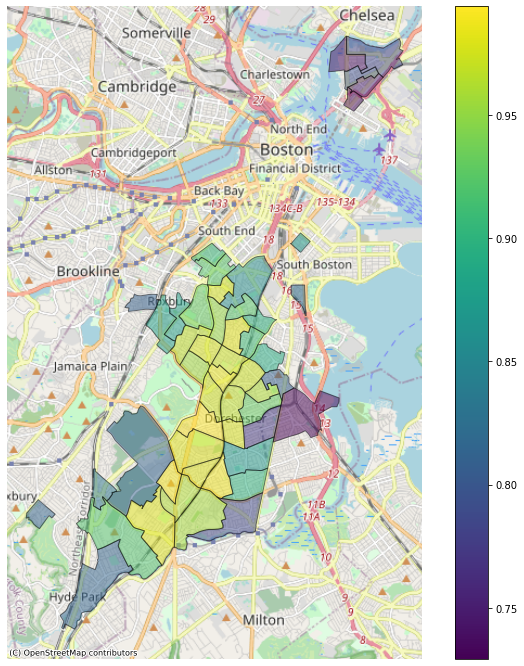

In [ ]:
ax = minority_svi_boston.to_crs('EPSG:3857').plot(column='non_white_perc',figsize=(12, 12), alpha=0.5, edgecolor='k',legend=True)
ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_axis_off()

/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 3
  Warn("Warning: setting k to %d" % k_q, UserWarning)


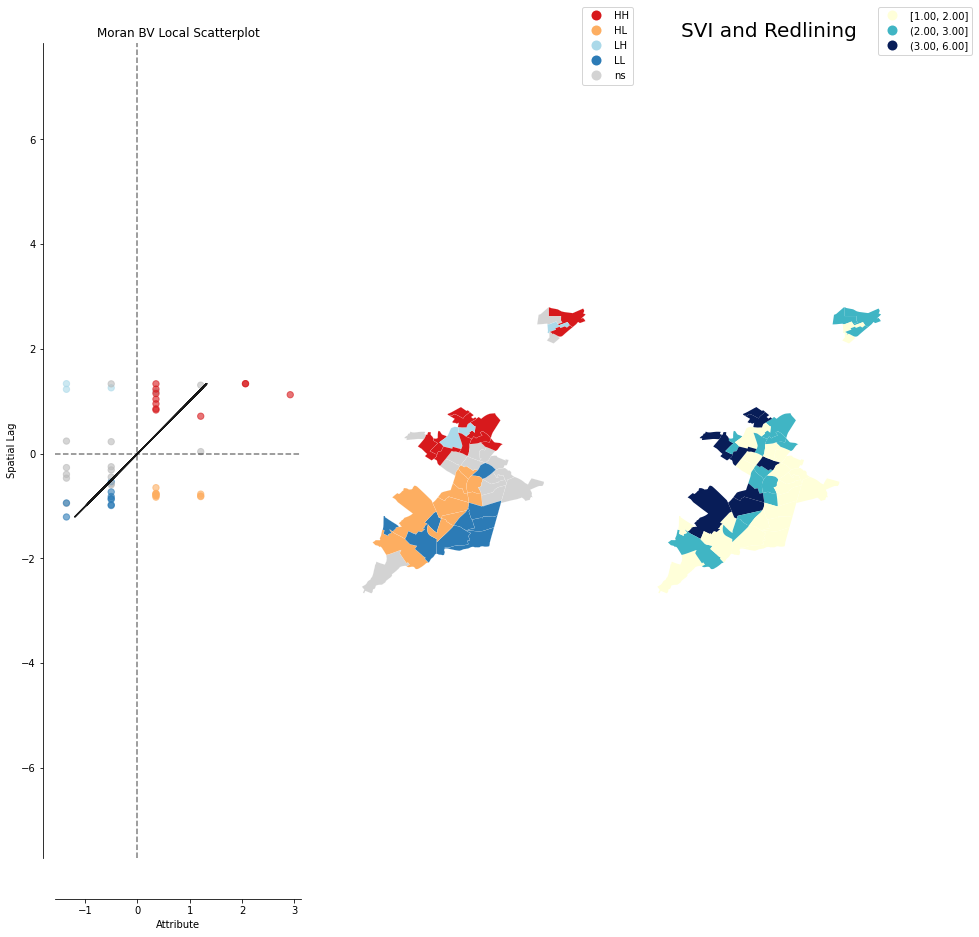

/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 3
  Warn("Warning: setting k to %d" % k_q, UserWarning)


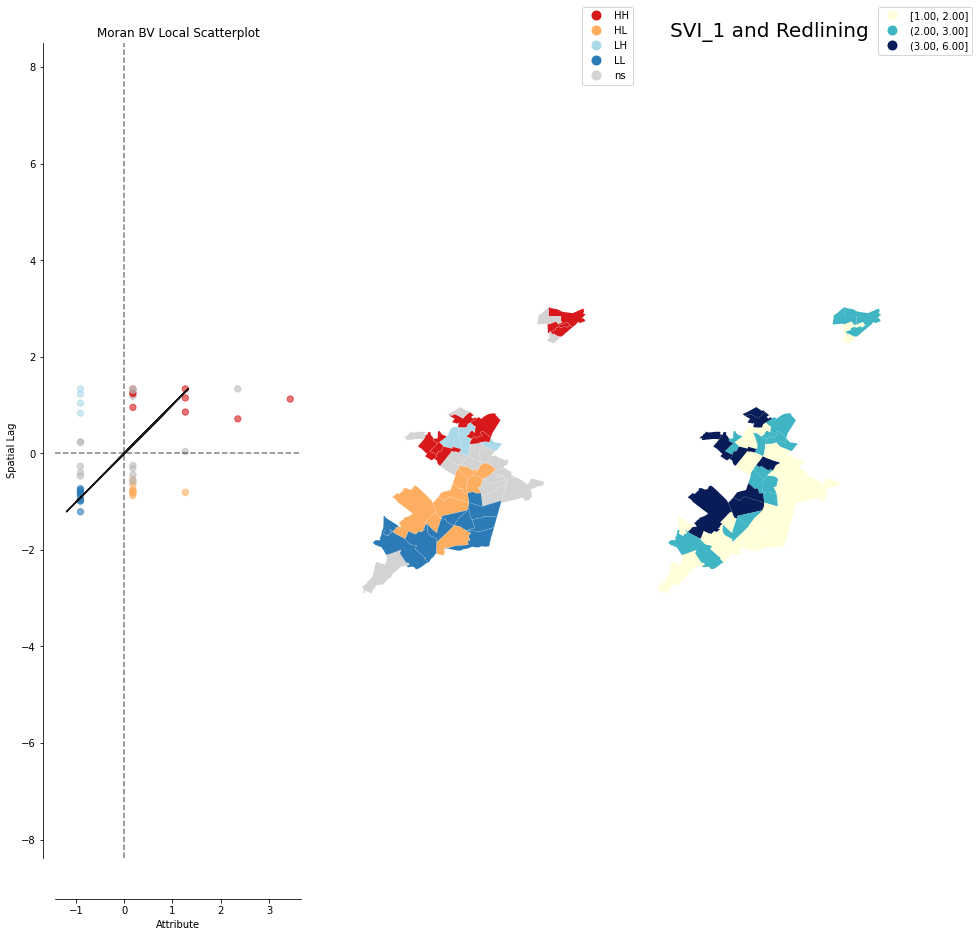

/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 3
  Warn("Warning: setting k to %d" % k_q, UserWarning)


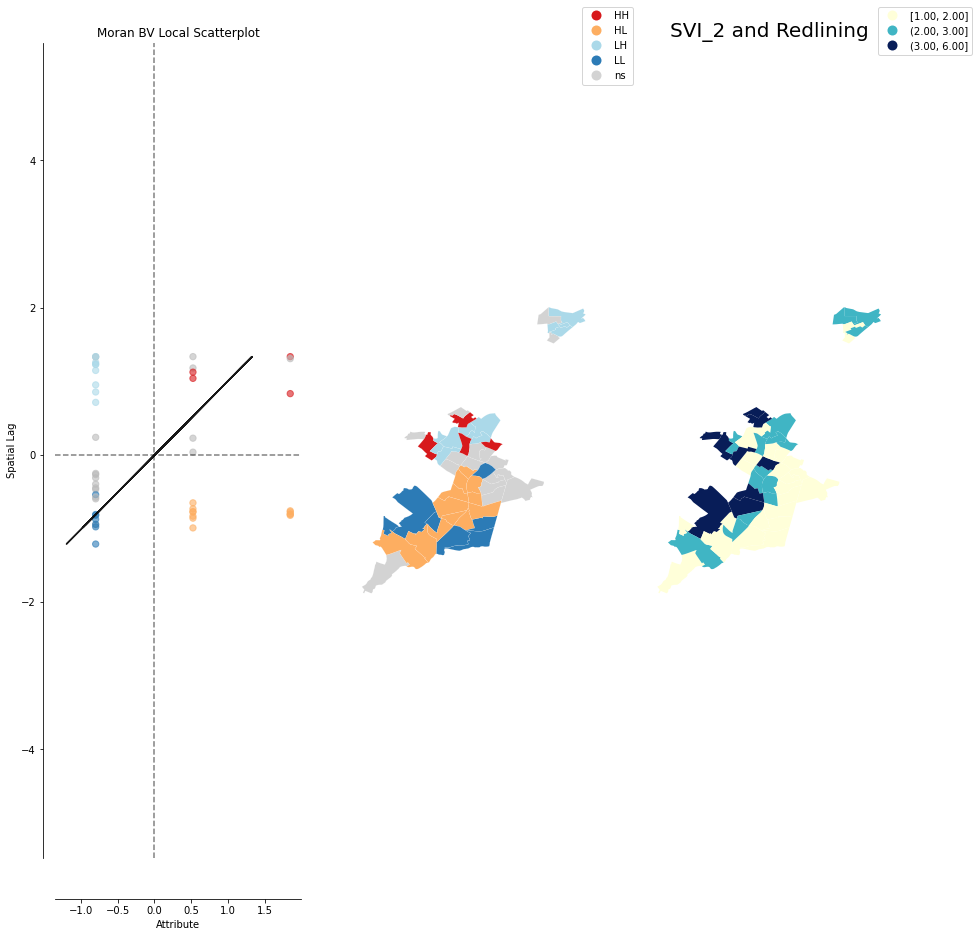

/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:226: RuntimeWarning: invalid value encountered in double_scalars
  k = k_num / k_den
/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:237: RuntimeWarning: invalid value encountered in double_scalars
  return self.n / self.w.s0 * inum / self.z2ss
/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:201: RuntimeWarning: invalid value encountered in true_divide
  self.z /= sy
/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:405: RuntimeWarning: invalid value encountered in true_divide
  zx = (x - x.mean()) / x.std(ddof=1)
<string>:6: UserWarning: Warning: converting a masked element to nan.
/shared-libs/python3.7/py/lib/python3.7/site-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in

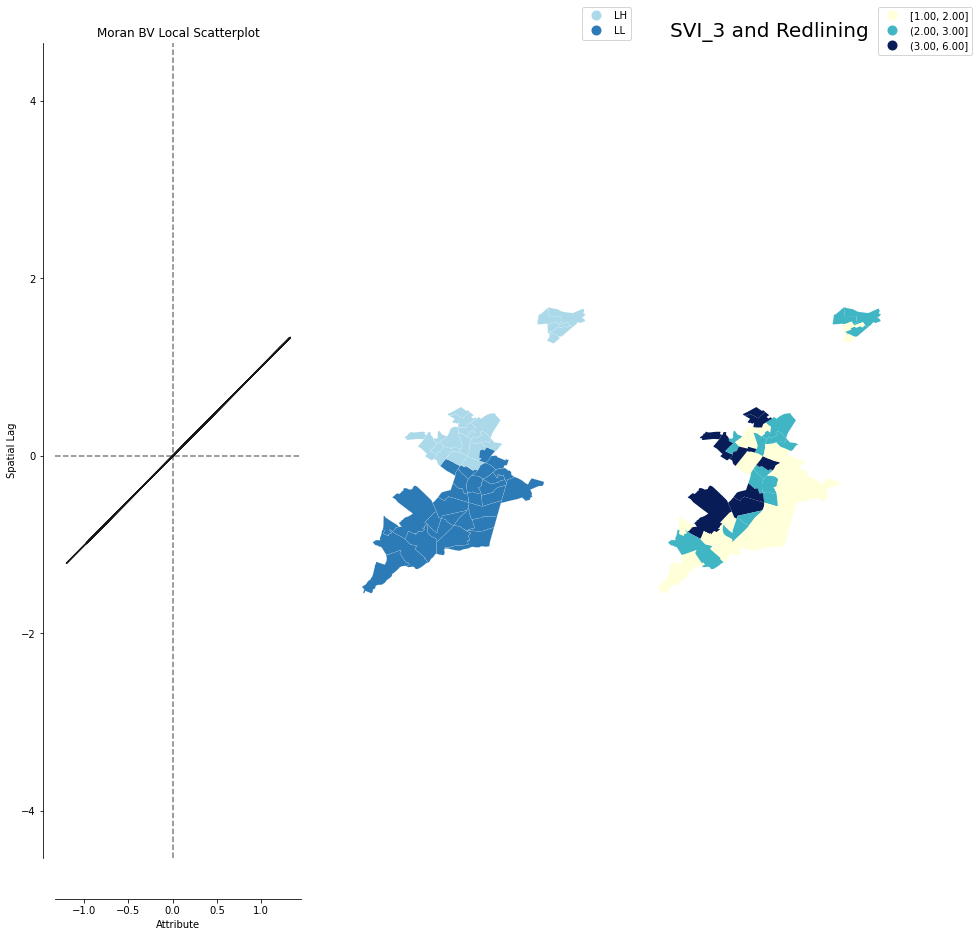

/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:235: UserWarning: Warning: Not enough unique values in array to form k classes
  "Warning: Not enough unique values in array to form k classes", UserWarning
/home/jovyan/venv/lib/python3.7/site-packages/mapclassify/classifiers.py:237: UserWarning: Warning: setting k to 3
  Warn("Warning: setting k to %d" % k_q, UserWarning)


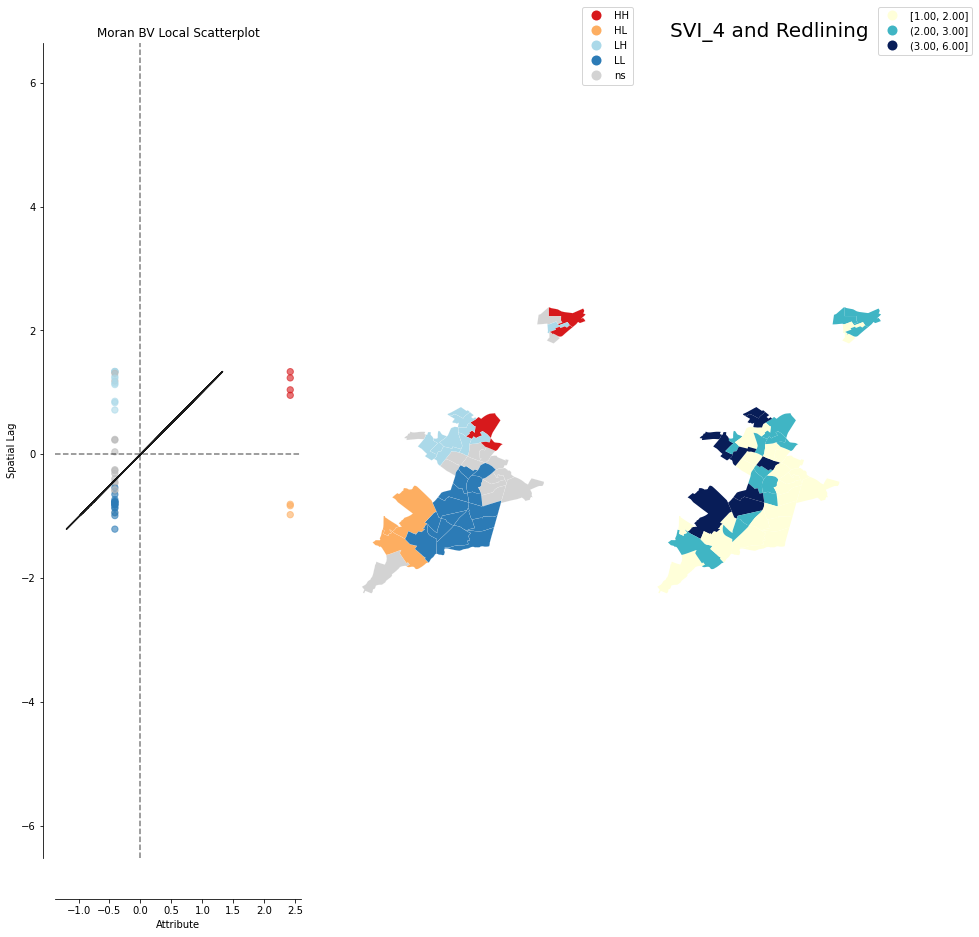

In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SVI','SES','Household_Composition','Minority','Housing_Transportation'])

#Dropping null values
minority_svi_boston = minority_svi_boston.dropna()

#Renaming columns 
minority_svi_boston = minority_svi_boston.rename(columns={'ordinal_value':'redlining_index'})

#Getting all SVI columns
SVI_corr_vars = ['SVI','SVI_1','SVI_2','SVI_3','SVI_4']

t = [25025061101.0,25025140106.0,25025060700.0]
minority_svi_boston = minority_svi_boston.loc[~minority_svi_boston.geo_id.isin(t)]

#Spatial transformations
w = Queen.from_dataframe(minority_svi_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SVI_corr_vars:
#Running spatial correlations
    y = minority_svi_boston[i].values
    x = minority_svi_boston['reweighted_redline_index'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    plot_local_autocorrelation(moran_loc_bv, minority_svi_boston, 'SVI', figsize=(15,15))
    #Adding a column for cluster values
    minority_svi_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    plt.title('{} and Redlining'.format(i), fontdict={'fontsize':20})
    plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

In [ ]:
spatial_corr.head()

,SVI,SES,Household_Composition,Minority,Housing_Transportation
0,0.289593,0.361819,-0.045232,NaN,0.113072


In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_spearman = pd.DataFrame(columns=['SVI','SVI_pval','SES','SES_pval','HouseholdComposition','HouseholdComposition_pval','Minority','Minority_pval','HousingTransportation','HousingTransportation_pval'])

#Storing values of correlation in a list
corr_list = []

SVI = ['SVI','SVI_1','SVI_2','SVI_3','SVI_4']

for i in SVI:
    
    #Making subset with dropped NA's
    minority_svi_boston_spearman = minority_svi_boston.copy()
    minority_svi_boston_spearman = minority_svi_boston_spearman.dropna()

    spearman_corr =  spearmanr(minority_svi_boston_spearman['reweighted_redline_index'], minority_svi_boston_spearman[i])[0]
    p_val = spearmanr(minority_svi_boston_spearman['reweighted_redline_index'], minority_svi_boston_spearman[i])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)

df_length = len(minority_spearman)
minority_spearman.loc[df_length] = corr_list
minority_spearman

/shared-libs/python3.7/py/lib/python3.7/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


,SVI,SVI_pval,SES,SES_pval,HouseholdComposition,HouseholdComposition_pval,Minority,Minority_pval,HousingTransportation,HousingTransportation_pval
0,0.145192,0.324803,0.280411,0.05355,-0.085166,0.564927,NaN,NaN,-0.042979,0.771775


In [ ]:
#Reassigning cluster values such that 1 = HH, 2 = HL, 3 = LH, 4 = LL
def cluster_assign(row):

    if row == 2:
        val = 3
    elif row == 3:
        val = 4
    elif row == 4:
        val = 2
    else:
        val = 1

    return val

In [ ]:
#Applying clusters

minority_svi_boston['SVI'] = minority_svi_boston['SVI'].apply(cluster_assign)
minority_svi_boston['SVI_1_cluster'] = minority_svi_boston['SVI_1_cluster'].apply(cluster_assign)
minority_svi_boston['SVI_2_cluster'] = minority_svi_boston['SVI_2_cluster'].apply(cluster_assign)
minority_svi_boston['SVI_3_cluster'] = minority_svi_boston['SVI_3_cluster'].apply(cluster_assign)
minority_svi_boston['SVI_4_cluster'] = minority_svi_boston['SVI_4_cluster'].apply(cluster_assign)

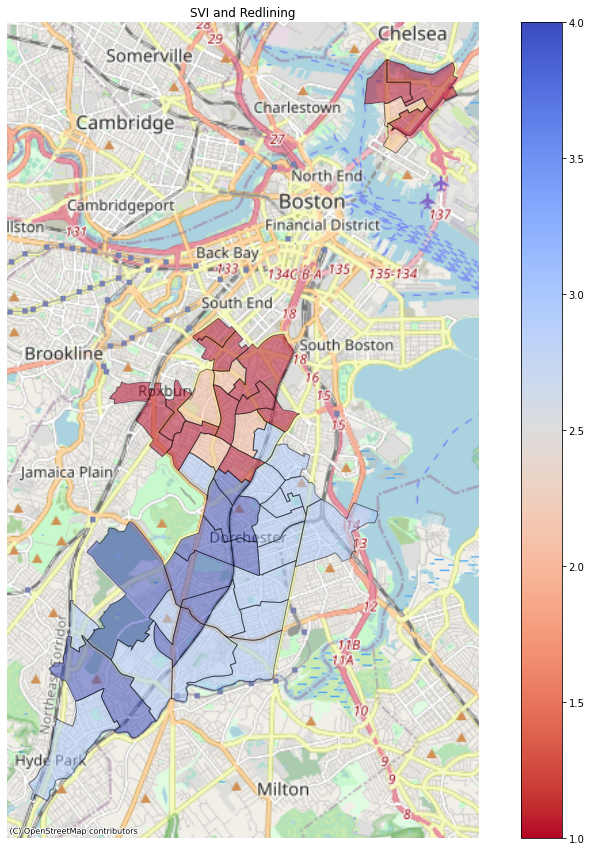

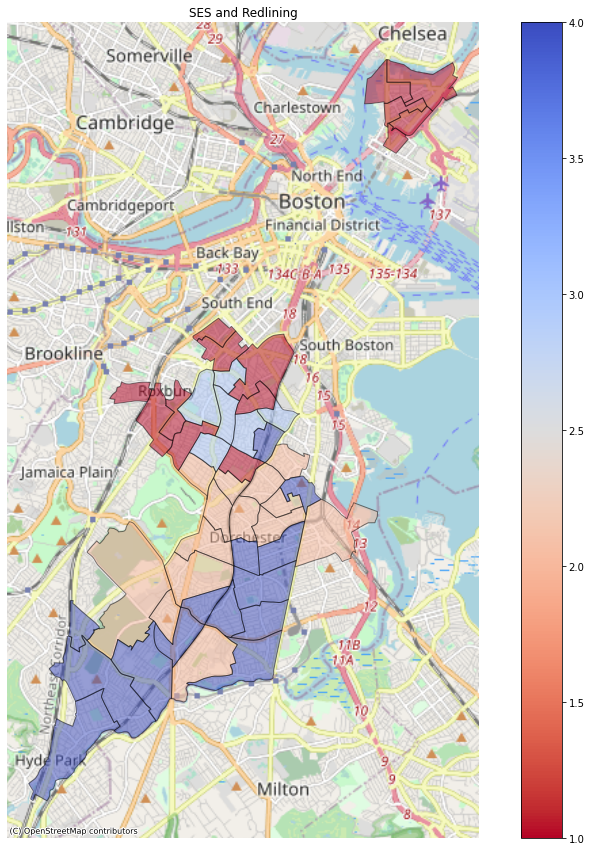

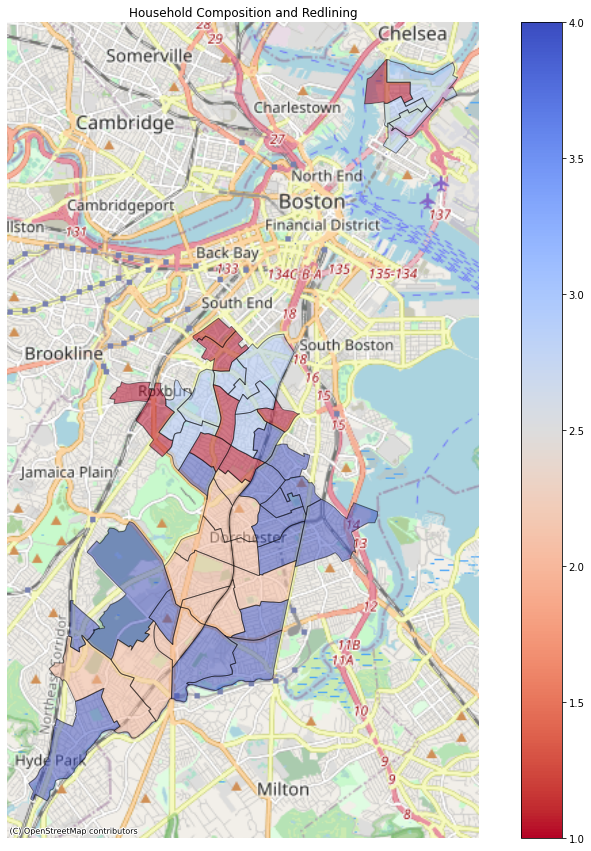

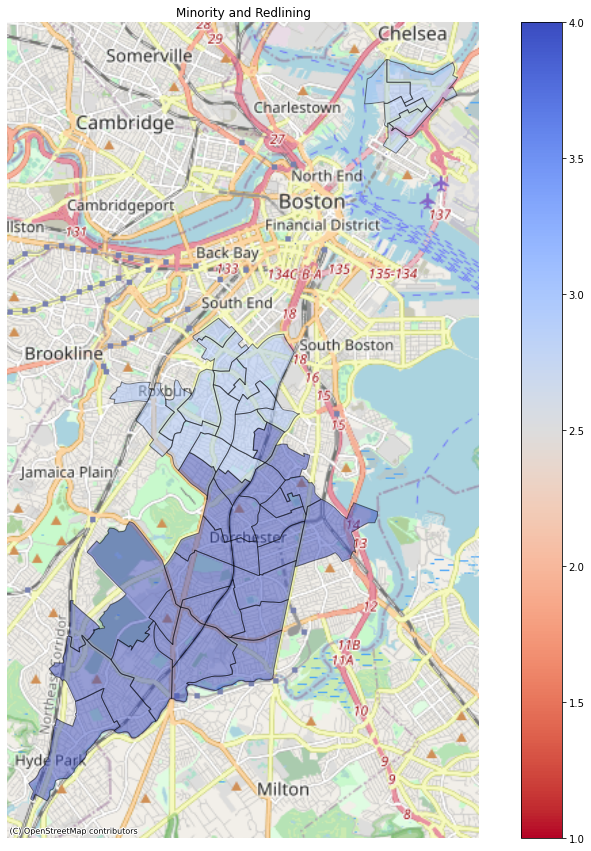

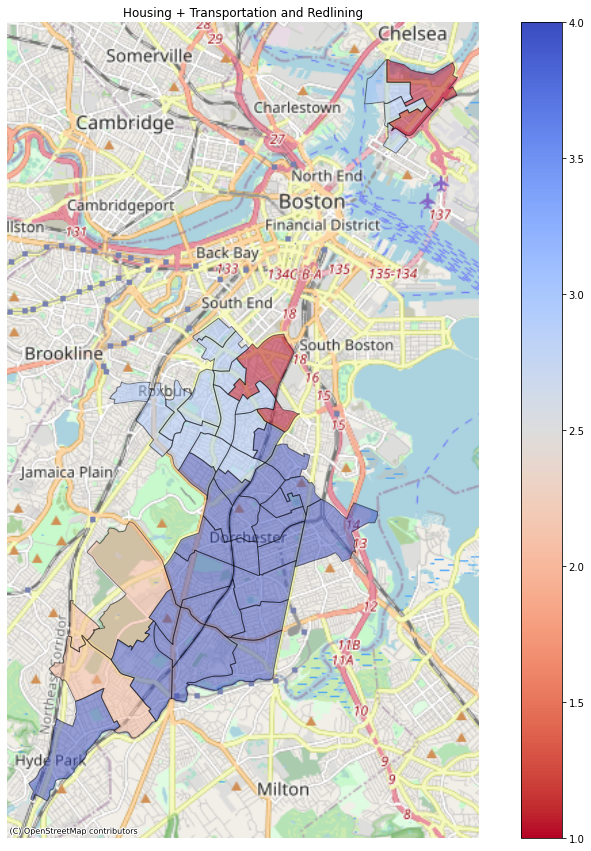

In [ ]:
#1 = (HH), 2 = (HL), 3 = (LH), 4 = (LL) where HH = High SVI, High Redlining, LH = Low SVI, High Redline

import contextily as ctx

cluster_list = ['SVI_cluster','SVI_1_cluster','SVI_2_cluster','SVI_3_cluster','SVI_4_cluster']
sviname = ['SVI','SES', 'Household Composition', 'Minority', 'Housing + Transportation']
for i,j in zip(cluster_list,sviname):
    ax = minority_svi_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "coolwarm_r",legend=True, vmin=1, vmax=4)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} and Redlining'.format(j))
    ax.set_axis_off()

### Correlations with rental prioritisation index

In [ ]:
#Loading rental prioritisation data for rental assistance index and minortiy percentage population visualisations
rent_data = gpd.read_file('/datasets/rent_prioritisation/housing_index_state_adj.geojson')
#Converting GEOID from string to float for merging
rent_data['GEOID'] = rent_data['GEOID'].astype(float)
rent_data = rent_data.rename(columns={'GEOID':'geo_id'})

#Merging SVI with geo df 
gdf_Boston = gdf_Boston.merge(rent_data[['geo_id','total_index_quantile']], on ='geo_id', how ='left')
gdf_Boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,mobile_homes,no_cars,group_quarters,pop_determined_poverty_status,total_pop,households,housing_units,reweighted_redline_index,redlining_index,total_index_quantile
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,0.0,1102.0,0.0,3145.0,3145.0,2008.0,2693.0,3.904488,4.0,0.66
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,0.0,317.0,0.0,2750.0,2817.0,1024.0,1056.0,3.725805,4.0,0.82
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,0.0,303.0,6.0,2559.0,2559.0,1177.0,1241.0,4.000000,4.0,0.43
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,0.0,81.0,7.0,2475.0,2475.0,929.0,995.0,3.000000,3.0,0.69
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,0.0,1242.0,18.0,5726.0,5750.0,2298.0,2377.0,3.000000,3.0,0.96


In [ ]:
gdf_Boston.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'geo_id', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'poverty', 'unemployed_pop', 'median_income', 'income_per_capita',
       'less_than_high_school_graduate', 'aged_65_or_older',
       'aged_17_or_younger', 'one_parent_families_with_young_children',
       'non_white', 'multi_unit_structures', 'mobile_homes', 'no_cars',
       'group_quarters', 'pop_determined_poverty_status', 'total_pop',
       'households', 'housing_units', 'reweighted_redline_index',
       'redlining_index', 'total_index_quantile'],
      dtype='object')

In [ ]:
# Remove duplicates and null values from the SVI-based variables dataset before further processing
gdf_Boston.drop_duplicates(inplace=True)
gdf_Boston.dropna(inplace=True)

In [ ]:
# Aggregating variables and normalising them
# Setting flags for the tracts which are ranked at 90th percentile and above

svi_rental_boston = gdf_Boston.copy()

svi_rental_boston['poverty_perc'] = svi_rental_boston['poverty']/svi_rental_boston['pop_determined_poverty_status']
svi_rental_boston['poverty_perc_bin'] = svi_rental_boston['poverty_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['poverty_perc'] >= svi_rental_boston['poverty_perc'].quantile(0.9), 'poverty_flag'] = 1
svi_rental_boston['poverty_flag'] = svi_rental_boston['poverty_flag'].fillna(0)

svi_rental_boston['unemployed_pop_perc'] = svi_rental_boston['unemployed_pop'] / svi_rental_boston['total_pop']
svi_rental_boston['unemployed_pop_perc_bin'] = svi_rental_boston['unemployed_pop_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['unemployed_pop_perc'] >= svi_rental_boston['unemployed_pop_perc'].quantile(0.9), 'unemployed_flag'] = 1
svi_rental_boston['unemployed_flag'] = svi_rental_boston['unemployed_flag'].fillna(0)

svi_rental_boston['less_than_high_school_graduate_perc'] = svi_rental_boston['less_than_high_school_graduate'] / svi_rental_boston['total_pop']
svi_rental_boston['less_than_high_school_graduate_perc_bin'] = svi_rental_boston['less_than_high_school_graduate_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['less_than_high_school_graduate_perc'] >= svi_rental_boston['less_than_high_school_graduate_perc'].quantile(0.9), 'less_than_high_school_graduate_flag'] = 1
svi_rental_boston['less_than_high_school_graduate_flag'] = svi_rental_boston['less_than_high_school_graduate_flag'].fillna(0)

svi_rental_boston['aged_65_or_older_perc'] = svi_rental_boston['aged_65_or_older'] / svi_rental_boston['total_pop']
svi_rental_boston['aged_65_or_older_perc_bin'] = svi_rental_boston['aged_65_or_older_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['aged_65_or_older_perc'] >= svi_rental_boston['aged_65_or_older_perc'].quantile(0.9), 'aged_65_or_older_flag'] = 1
svi_rental_boston['aged_65_or_older_flag'] = svi_rental_boston['aged_65_or_older_flag'].fillna(0)

svi_rental_boston['aged_17_or_younger_perc'] = svi_rental_boston['aged_17_or_younger'] / svi_rental_boston['total_pop']
svi_rental_boston['aged_17_or_younger_perc_bin'] = svi_rental_boston['aged_17_or_younger_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['aged_17_or_younger_perc'] >= svi_rental_boston['aged_17_or_younger_perc'].quantile(0.9), 'aged_17_or_younger_flag'] = 1
svi_rental_boston['aged_17_or_younger_flag'] = svi_rental_boston['aged_17_or_younger_flag'].fillna(0)

svi_rental_boston['one_parent_families_with_young_children_perc'] = svi_rental_boston['one_parent_families_with_young_children'] / svi_rental_boston['households']
svi_rental_boston['one_parent_families_with_young_children_perc_bin'] = svi_rental_boston['one_parent_families_with_young_children_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['one_parent_families_with_young_children_perc'] >= svi_rental_boston['one_parent_families_with_young_children_perc'].quantile(0.9), 'one_parent_families_with_young_children_flag'] = 1
svi_rental_boston['one_parent_families_with_young_children_flag'] = svi_rental_boston['one_parent_families_with_young_children_flag'].fillna(0)

svi_rental_boston['multi_unit_structures_perc'] = svi_rental_boston['multi_unit_structures'] / svi_rental_boston['housing_units']
svi_rental_boston['multi_unit_structures_perc_bin'] = svi_rental_boston['multi_unit_structures_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['multi_unit_structures_perc'] >= svi_rental_boston['multi_unit_structures_perc'].quantile(0.9), 'multi_unit_structures_flag'] = 1
svi_rental_boston['multi_unit_structures_flag'] = svi_rental_boston['multi_unit_structures_flag'].fillna(0)

svi_rental_boston['mobile_homes_perc'] = svi_rental_boston['mobile_homes'] / svi_rental_boston['housing_units']
svi_rental_boston['mobile_homes_perc_bin'] = svi_rental_boston['mobile_homes_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['mobile_homes_perc'] >= svi_rental_boston['mobile_homes_perc'].quantile(0.9), 'mobile_homes_flag'] = 1
svi_rental_boston['mobile_homes_flag'] = svi_rental_boston['mobile_homes_flag'].fillna(0)

svi_rental_boston['no_cars_perc'] = svi_rental_boston['no_cars'] / svi_rental_boston['households']
svi_rental_boston['no_cars_perc_bin'] = svi_rental_boston['no_cars_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['no_cars_perc'] >= svi_rental_boston['no_cars_perc'].quantile(0.9), 'no_cars_flag'] = 1
svi_rental_boston['no_cars_flag'] = svi_rental_boston['no_cars_flag'].fillna(0)

svi_rental_boston['group_quarters_perc'] = svi_rental_boston['group_quarters'] / svi_rental_boston['total_pop']
svi_rental_boston['group_quarters_perc_bin'] = svi_rental_boston['group_quarters_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['group_quarters_perc'] >= svi_rental_boston['group_quarters_perc'].quantile(0.9), 'group_quarters_flag'] = 1
svi_rental_boston['group_quarters_flag'] = svi_rental_boston['group_quarters_flag'].fillna(0)

In [ ]:
# Repeat flag setting for variables which do not requirea normalisation
# Setting flags for the tracts which are ranked at 90th percentile and above

svi_rental_boston.loc[svi_rental_boston['median_income'] <= svi_rental_boston['median_income'].quantile(0.1), 'median_income_flag'] = 1
svi_rental_boston['median_income_flag'] = svi_rental_boston['median_income_flag'].fillna(0)

svi_rental_boston.loc[svi_rental_boston['income_per_capita'] <= svi_rental_boston['income_per_capita'].quantile(0.1), 'income_per_capita_flag'] = 1
svi_rental_boston['income_per_capita_flag'] = svi_rental_boston['income_per_capita_flag'].fillna(0)

In [ ]:
svi_rental_boston['non_white_perc'] = svi_rental_boston['non_white'] / svi_rental_boston['total_pop']
svi_rental_boston['non_white_perc_bin'] = svi_rental_boston['non_white_perc'].apply(perc_bin)
svi_rental_boston.loc[svi_rental_boston['non_white_perc'] >= svi_rental_boston['non_white_perc'].quantile(0.7), 'non_white_flag'] = 1
svi_rental_boston['non_white_flag'] = svi_rental_boston['non_white_flag'].fillna(0)

# The number of flags (for each tract), all SVI-based variables
svi_rental_boston['SVI'] = svi_rental_boston['poverty_flag'] + svi_rental_boston['unemployed_flag'] + svi_rental_boston['median_income_flag'] + svi_rental_boston['income_per_capita_flag'] + svi_rental_boston['less_than_high_school_graduate_flag'] + svi_rental_boston['aged_65_or_older_flag'] + svi_rental_boston['aged_17_or_younger_flag'] + svi_rental_boston['one_parent_families_with_young_children_flag'] + svi_rental_boston['non_white_flag'] + svi_rental_boston['multi_unit_structures_flag'] + svi_rental_boston['mobile_homes_flag'] + svi_rental_boston['no_cars_flag'] + svi_rental_boston['group_quarters_flag']

# The number of flags (for each tract); Theme#1: Socioeconomic Status
svi_rental_boston['SVI_1'] = svi_rental_boston['poverty_flag'] + svi_rental_boston['unemployed_flag'] + svi_rental_boston['median_income_flag'] + svi_rental_boston['income_per_capita_flag'] + svi_rental_boston['less_than_high_school_graduate_flag']

# The number of flags (for each tract); Theme#2: Household Composition & Disability
svi_rental_boston['SVI_2'] = svi_rental_boston['aged_65_or_older_flag'] + svi_rental_boston['aged_17_or_younger_flag'] + svi_rental_boston['one_parent_families_with_young_children_flag']

# The number of flags (for each tract); Theme#3: Minority Status & Language
svi_rental_boston['SVI_3'] = svi_rental_boston['non_white_flag']

# The number of flags (for each tract); Theme#4: Housing Type & Transportation
svi_rental_boston['SVI_4'] = svi_rental_boston['multi_unit_structures_flag'] + svi_rental_boston['mobile_homes_flag'] + svi_rental_boston['no_cars_flag'] + svi_rental_boston['group_quarters_flag']

[0.30933525636551634]


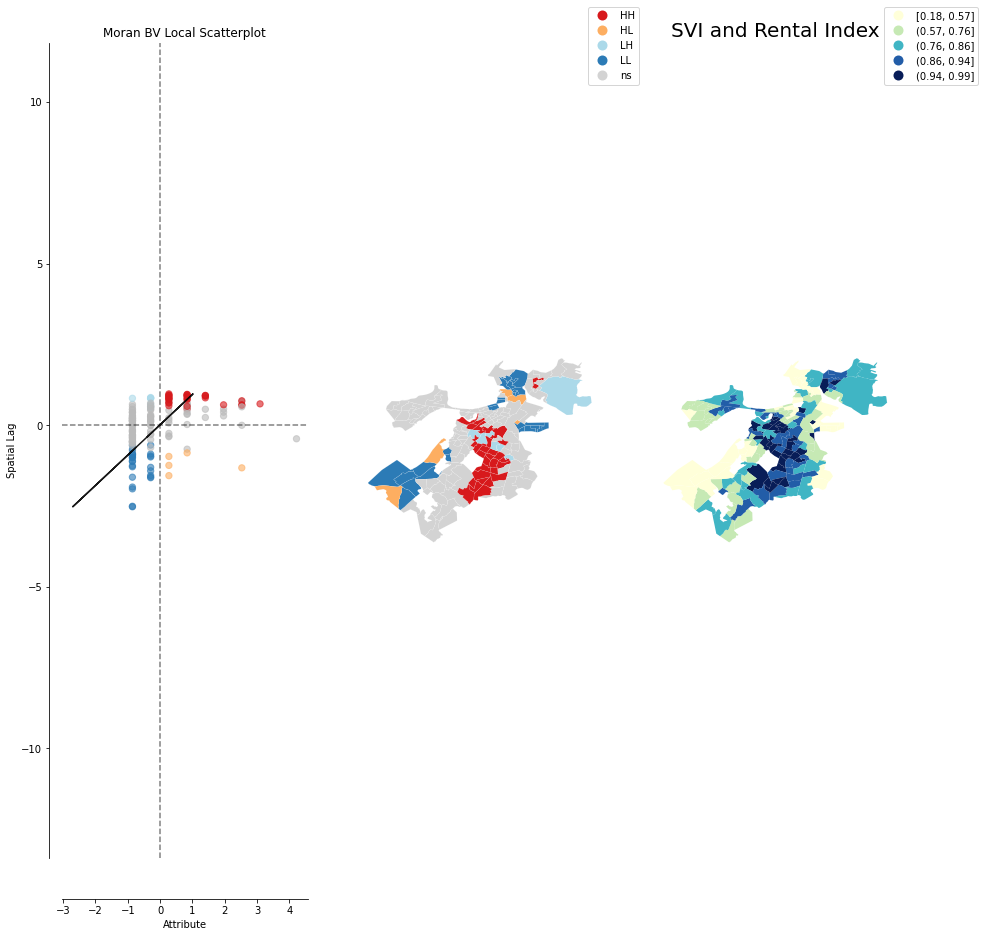

[0.30933525636551634, 0.22163416675218314]


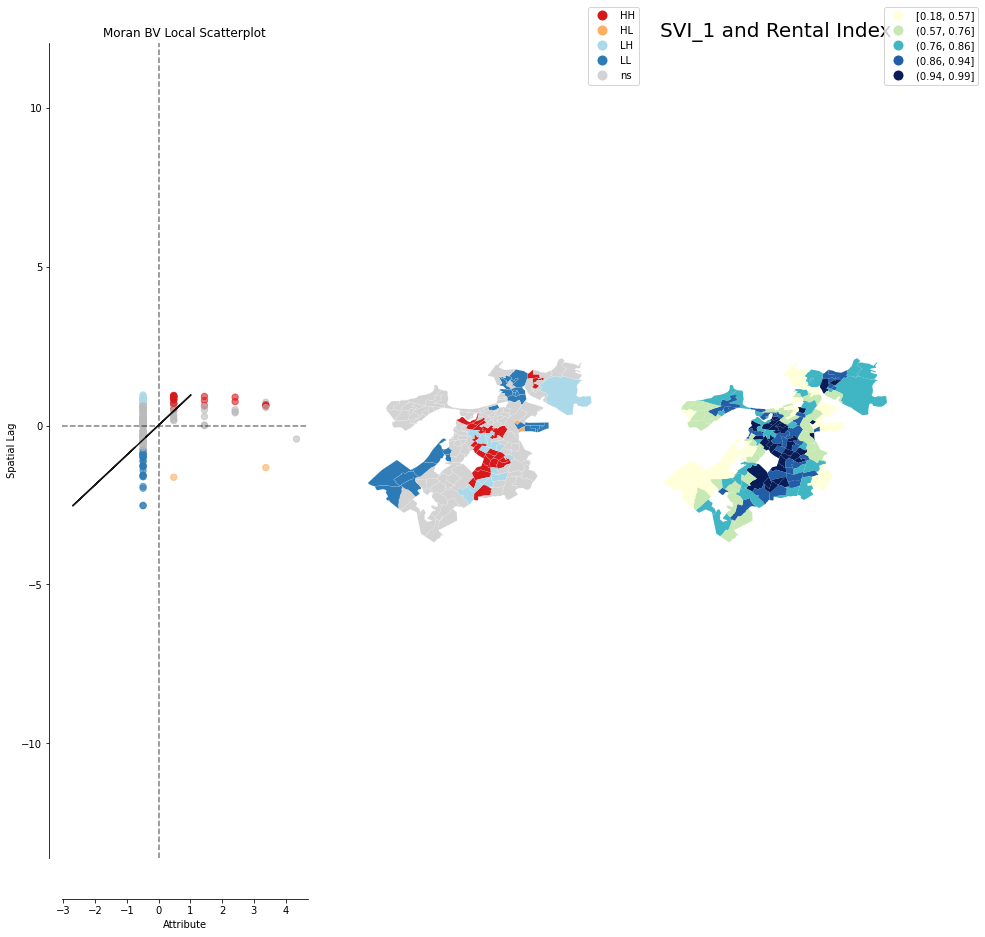

[0.30933525636551634, 0.22163416675218314, 0.07840222635539242]


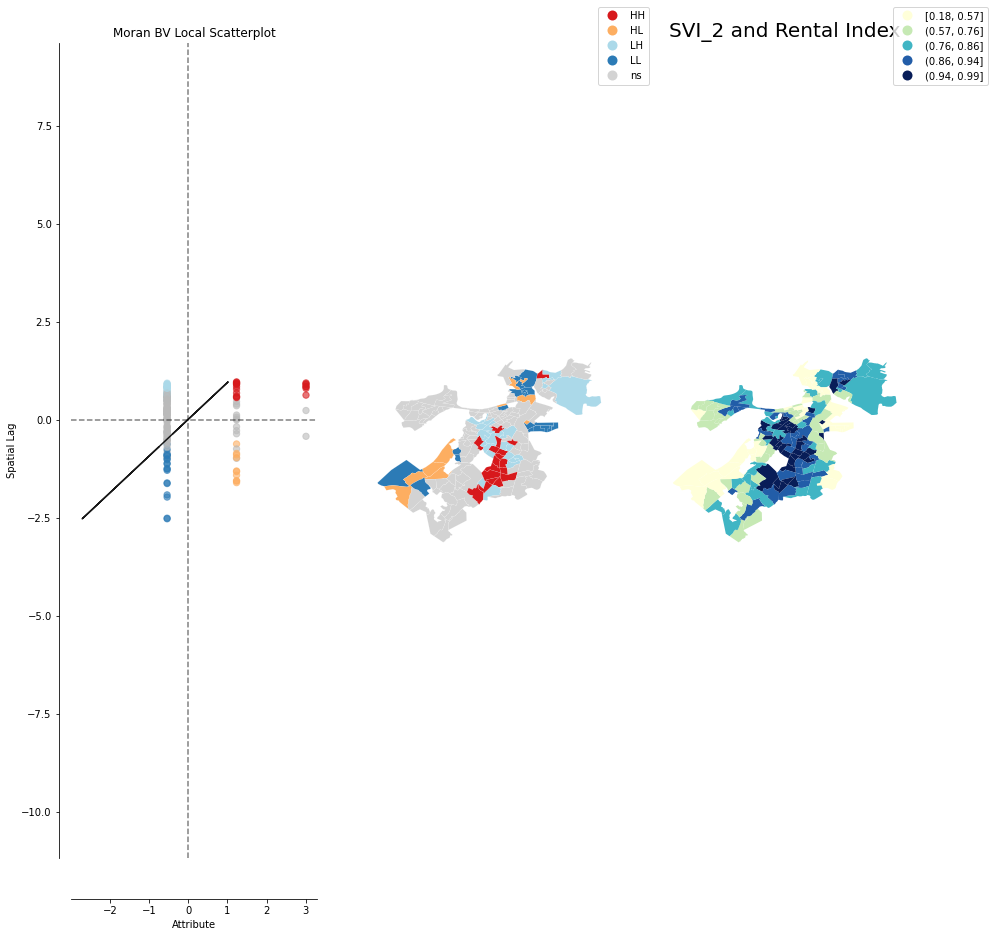

[0.30933525636551634, 0.22163416675218314, 0.07840222635539242, 0.43445848460895]


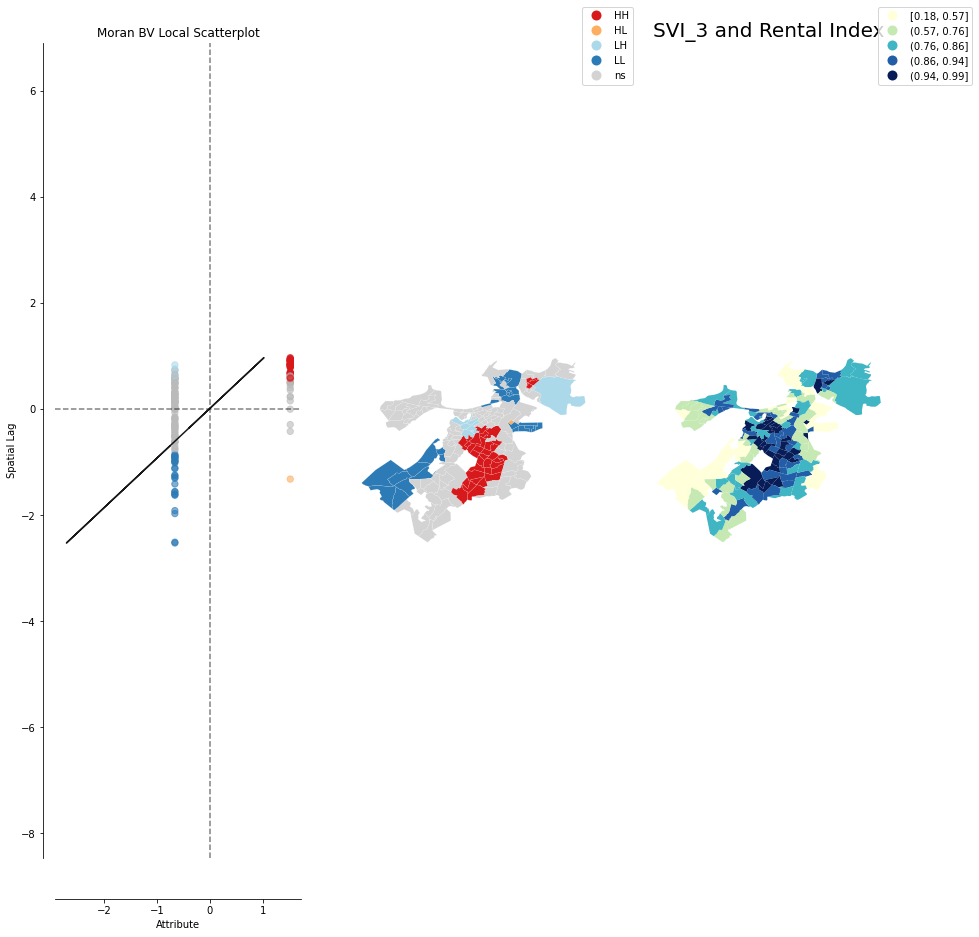

[0.30933525636551634, 0.22163416675218314, 0.07840222635539242, 0.43445848460895, 0.09413392213566778]


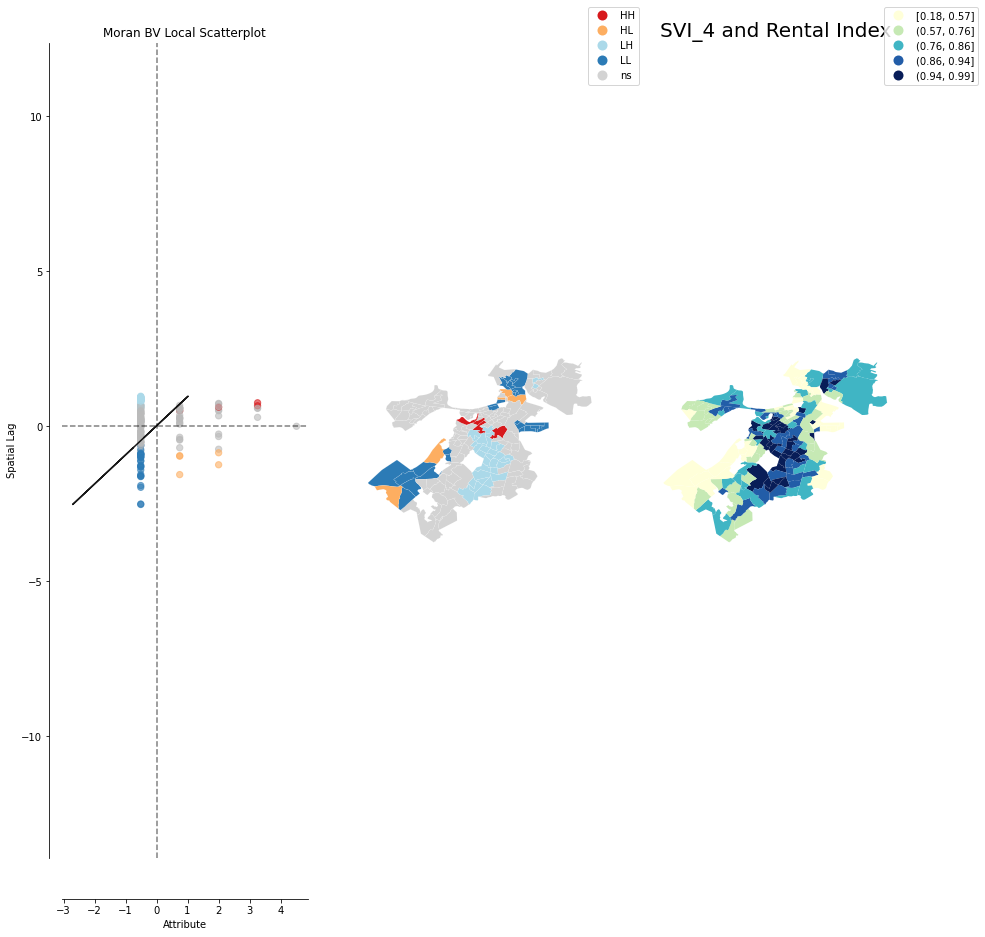

In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SVI','SES','Household_Composition','Minority','Housing_Transportation'])

#Dropping null values
svi_rental_boston = svi_rental_boston.dropna()

#Renaming columns 
svi_rental_boston = svi_rental_boston.rename(columns={'total_index_quantile':'rental_index'})

#Getting all SVI columns
SVI_corr_vars = ['SVI','SVI_1','SVI_2','SVI_3','SVI_4']

#Spatial transformations
w = Queen.from_dataframe(svi_rental_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SVI_corr_vars:
#Running spatial correlations
    y = svi_rental_boston[i].values
    x = svi_rental_boston['rental_index'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    print(corr_list)
    plot_local_autocorrelation(moran_loc_bv, svi_rental_boston,'rental_index', figsize=(15,15))
    #Adding a column for cluster values
    svi_rental_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    plt.title('{} and Rental Index'.format(i), fontdict={'fontsize':20})
    plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

In [ ]:
spatial_corr.head()

,SVI,SES,Household_Composition,Minority,Housing_Transportation
0,0.309335,0.221634,0.078402,0.434458,0.094134


In [ ]:
#Applying clusters

svi_rental_boston['SVI'] = svi_rental_boston['SVI'].apply(cluster_assign)
svi_rental_boston['SVI_1_cluster'] = svi_rental_boston['SVI_1_cluster'].apply(cluster_assign)
svi_rental_boston['SVI_2_cluster'] = svi_rental_boston['SVI_2_cluster'].apply(cluster_assign)
svi_rental_boston['SVI_3_cluster'] = svi_rental_boston['SVI_3_cluster'].apply(cluster_assign)
svi_rental_boston['SVI_4_cluster'] = svi_rental_boston['SVI_4_cluster'].apply(cluster_assign)

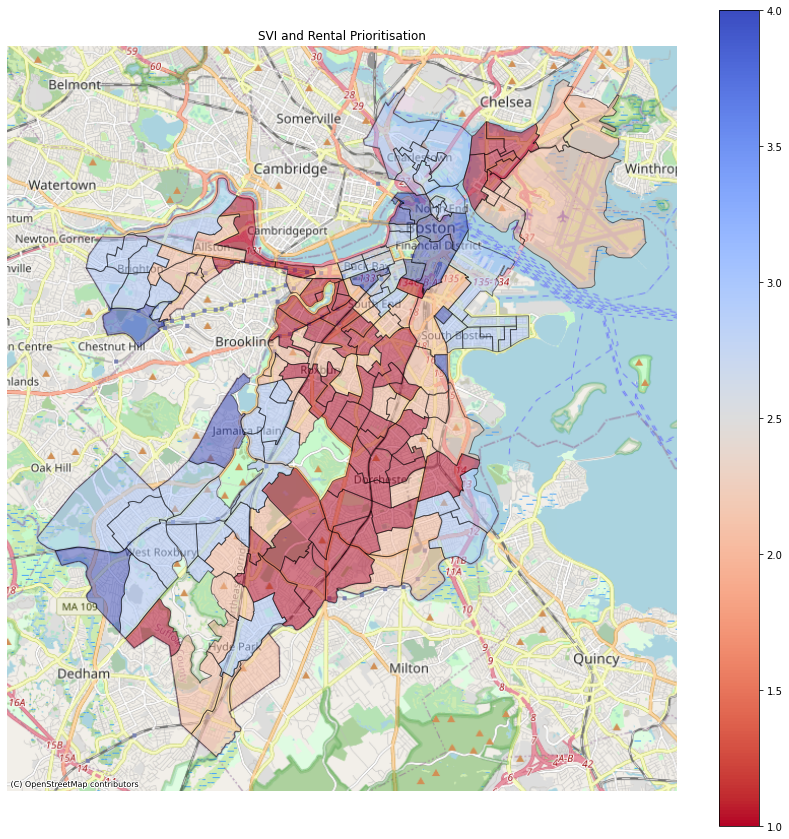

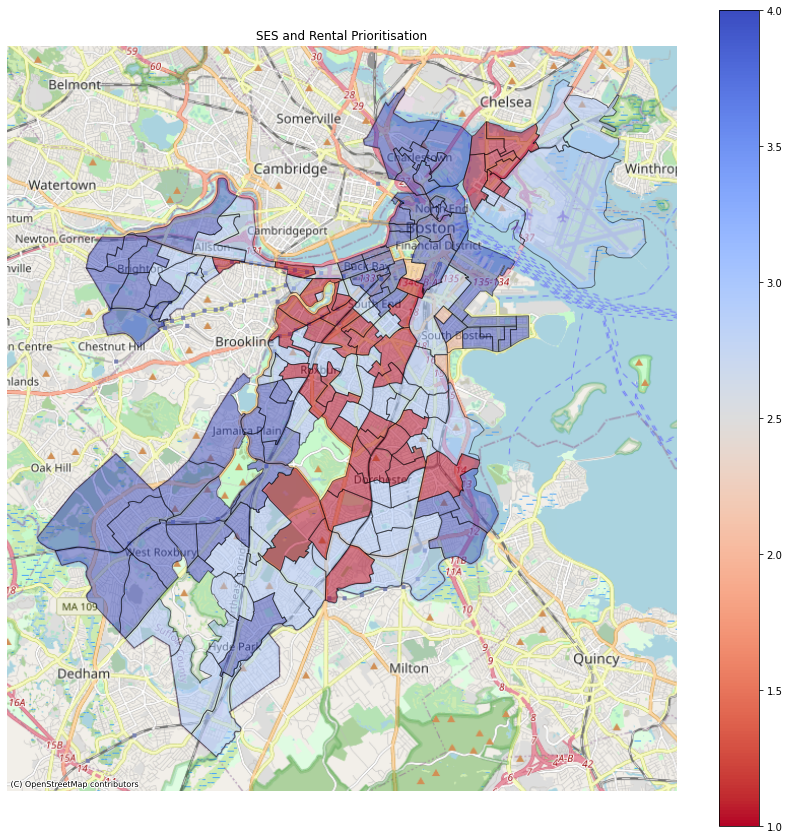

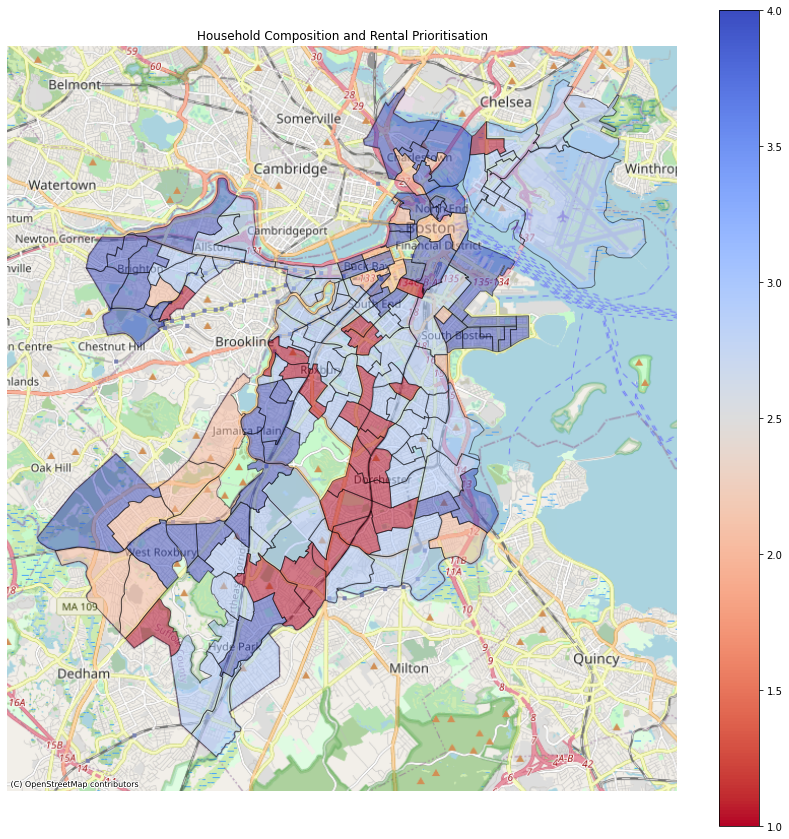

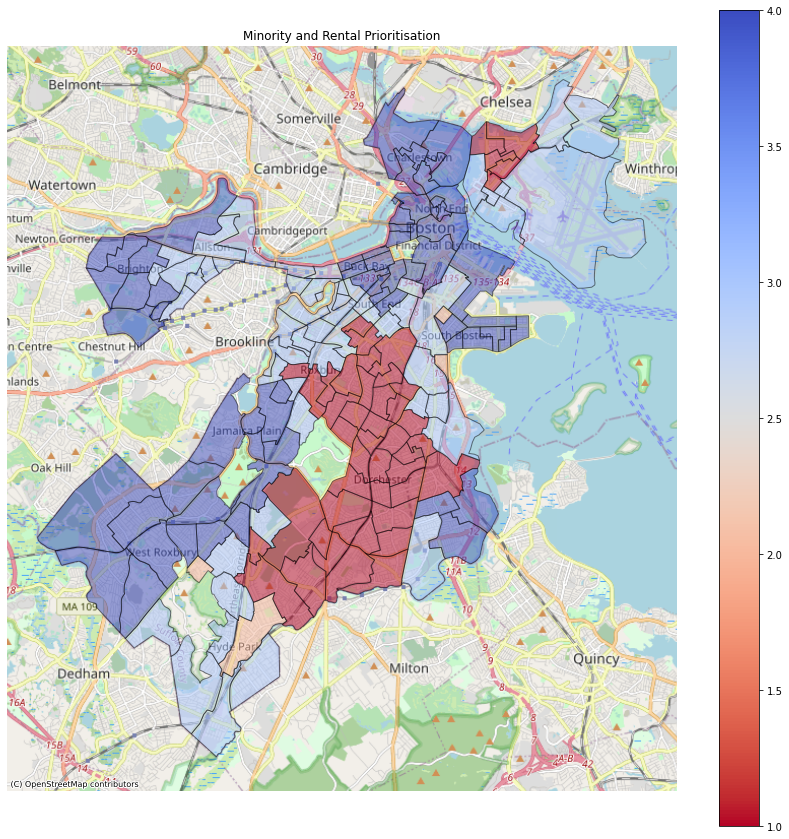

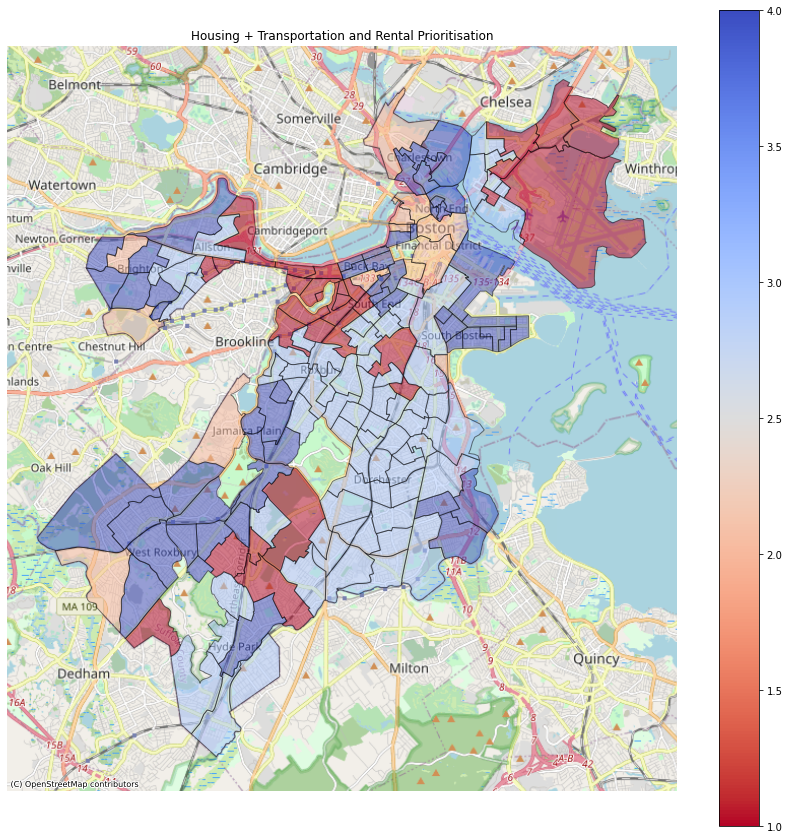

In [ ]:
#1 = (HH), 2 = (HL), 3 = (LH), 4 = (LL) where HH = High SVI, High Redlining, LH = Low SVI, High Redline

import contextily as ctx

cluster_list = ['SVI_cluster','SVI_1_cluster','SVI_2_cluster','SVI_3_cluster','SVI_4_cluster']
for i,j in zip(cluster_list,sviname):
    ax = svi_rental_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "coolwarm_r",legend=True)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} and Rental Prioritisation'.format(j))
    ax.set_axis_off()

In [ ]:
## Separating tracts with greater than 70% minority population
minority_svi_boston = svi_rental_boston[svi_rental_boston['non_white_flag'] == 1]

In [ ]:
minority_svi_boston.iloc[2]['geo_id']

25025080300.0

/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
[0.05279632453345739]


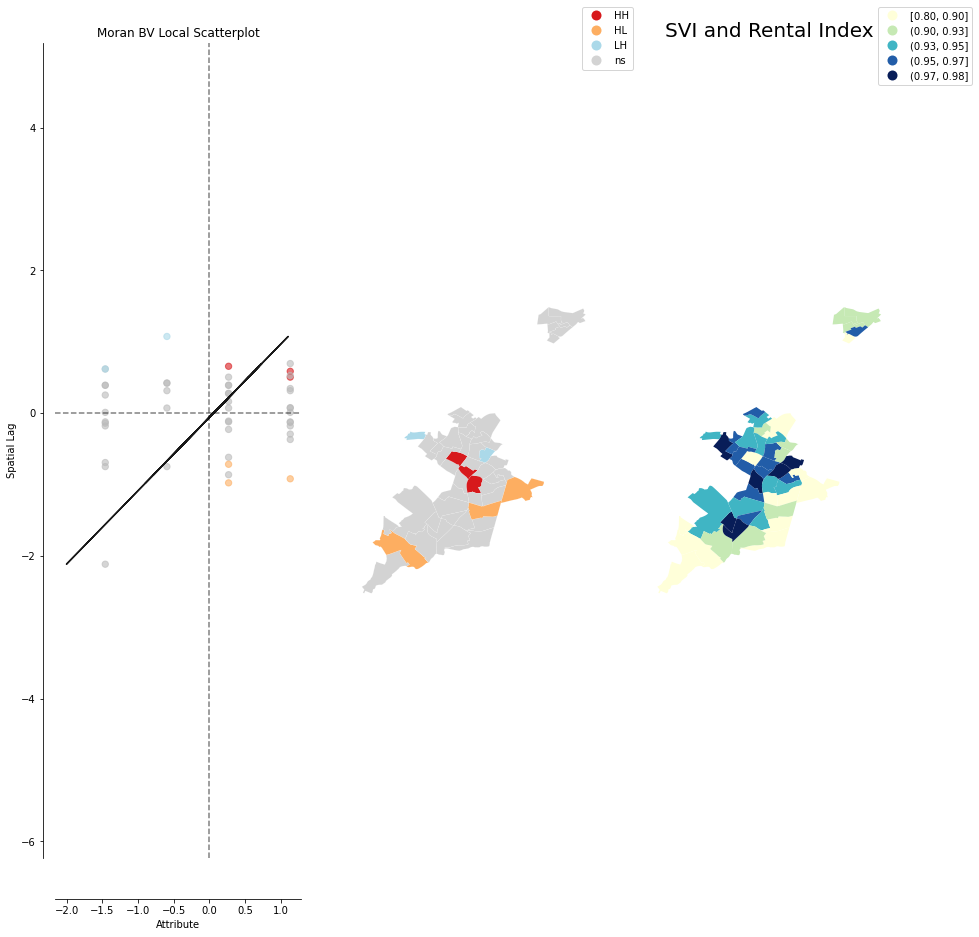

[0.05279632453345739, 0.15785851005915202]


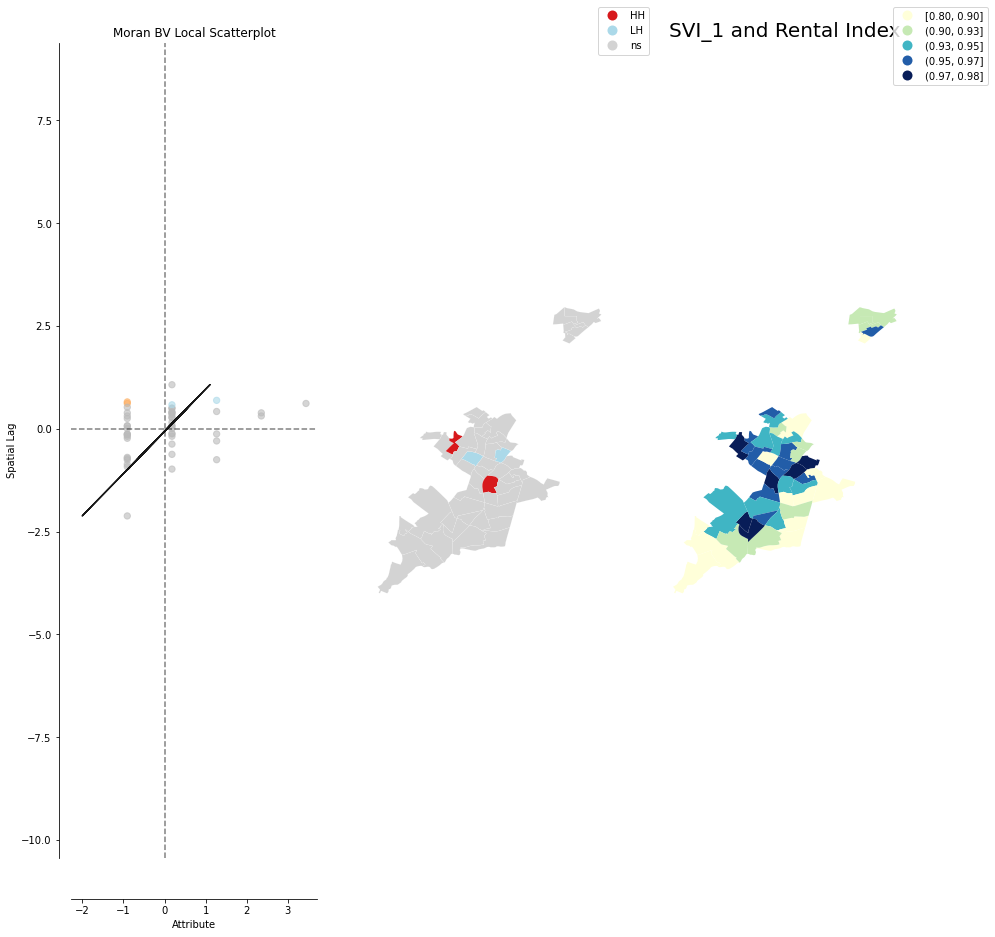

[0.05279632453345739, 0.15785851005915202, 0.15719837120727767]


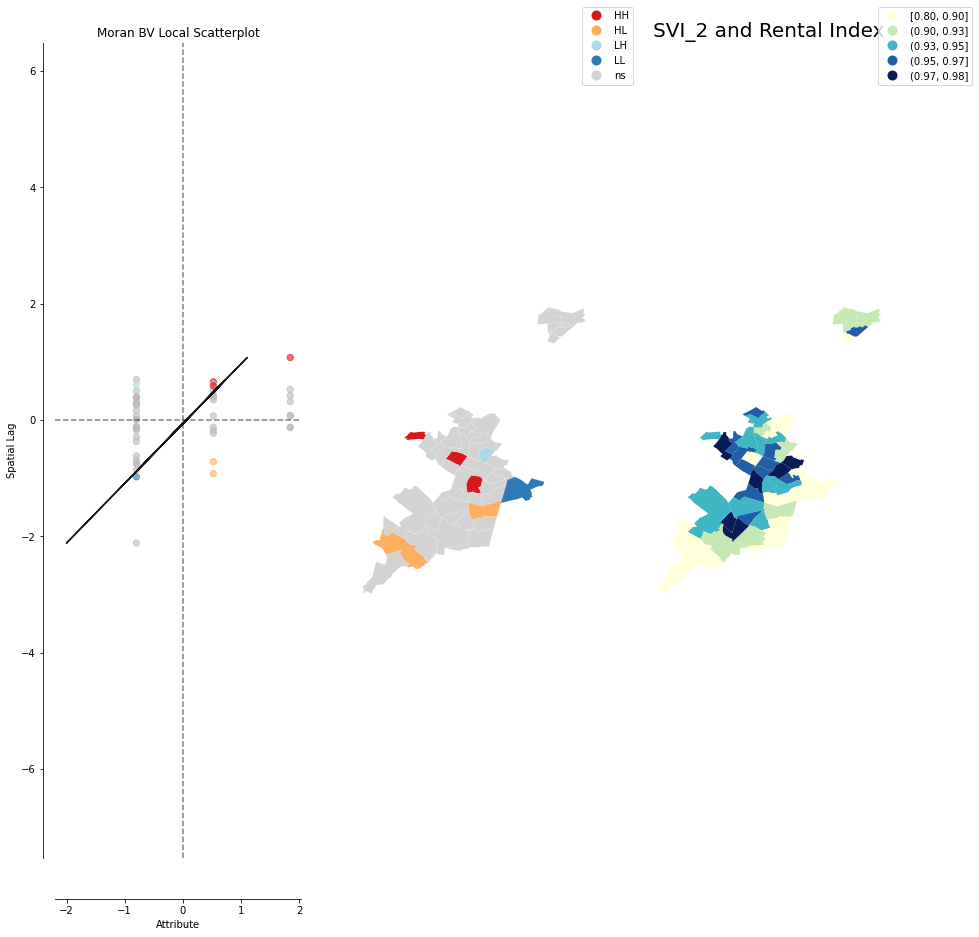

/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:226: RuntimeWarning: invalid value encountered in double_scalars
  k = k_num / k_den
/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:237: RuntimeWarning: invalid value encountered in double_scalars
  return self.n / self.w.s0 * inum / self.z2ss
/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:201: RuntimeWarning: invalid value encountered in true_divide
  self.z /= sy
/home/jovyan/venv/lib/python3.7/site-packages/esda/moran.py:405: RuntimeWarning: invalid value encountered in true_divide
  zx = (x - x.mean()) / x.std(ddof=1)
<string>:6: UserWarning: Warning: converting a masked element to nan.
/shared-libs/python3.7/py/lib/python3.7/site-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
[0.05279632453345739, 0.15785851005915202, 0.15719837120727767, nan]


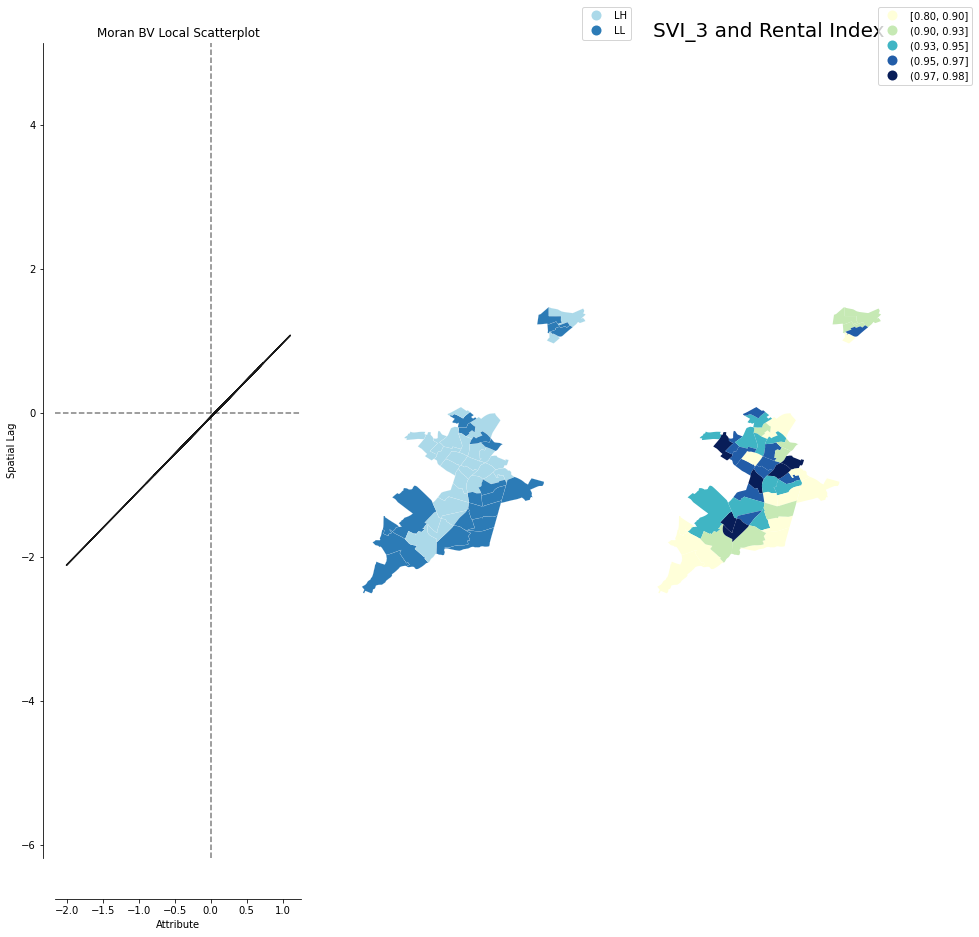

[0.05279632453345739, 0.15785851005915202, 0.15719837120727767, nan, -0.16940093058315003]


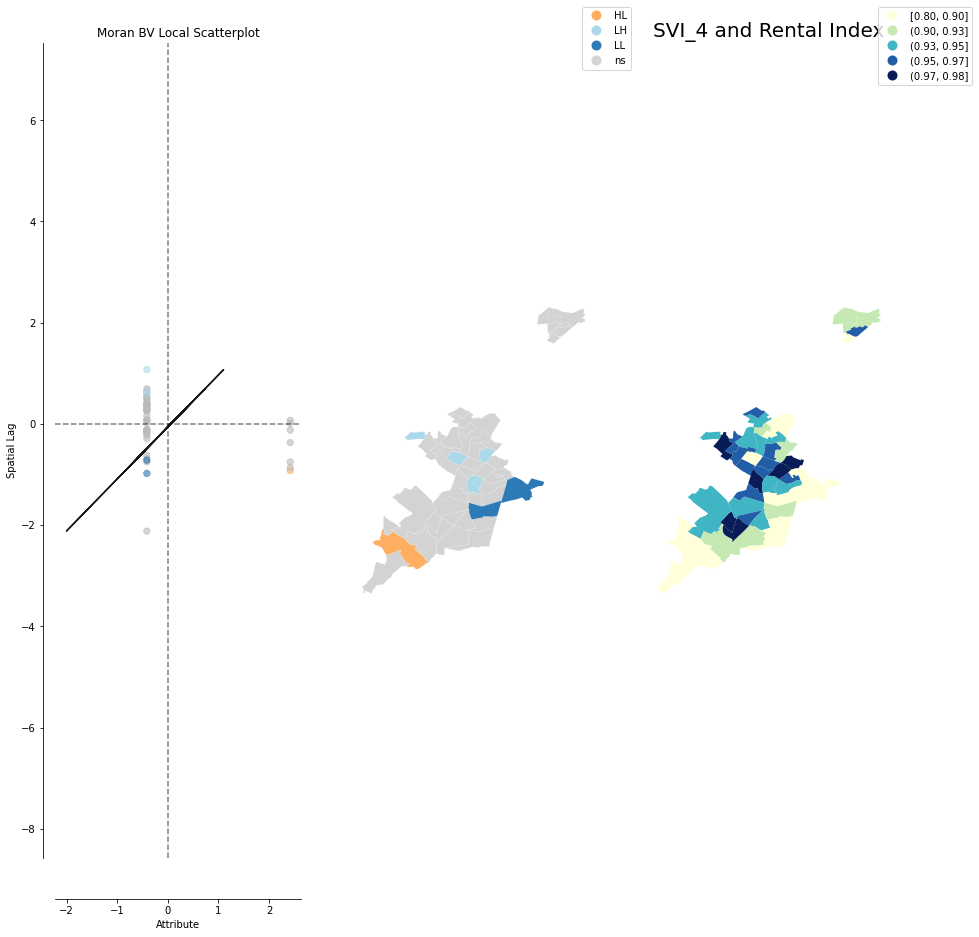

In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SVI','SES','Household_Composition','Minority','Housing_Transportation'])

#Dropping null values
minority_svi_boston = minority_svi_boston.dropna()

#Renaming columns 
minority_svi_boston = minority_svi_boston.rename(columns={'total_index_quantile':'rental_index'})

#Getting all SVI columns
SVI_corr_vars = ['SVI','SVI_1','SVI_2','SVI_3','SVI_4']

t = [25025061101.0,25025140106.0,25025060700.0]
minority_svi_boston = minority_svi_boston.loc[~minority_svi_boston.geo_id.isin(t)]

#Spatial transformations
w = Queen.from_dataframe(minority_svi_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SVI_corr_vars:
#Running spatial correlations
    y = minority_svi_boston[i].values
    x = minority_svi_boston['rental_index'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    print(corr_list)
    plot_local_autocorrelation(moran_loc_bv, minority_svi_boston,'rental_index', figsize=(15,15))
    #Adding a column for cluster values
    minority_svi_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    plt.title('{} and Rental Index'.format(i), fontdict={'fontsize':20})
    plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

In [ ]:
spatial_corr.head()

,SVI,SES,Household_Composition,Minority,Housing_Transportation
0,0.052796,0.157859,0.157198,NaN,-0.169401


In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_spearman = pd.DataFrame(columns=['SVI','SVI_pval','SES','SES_pval','HouseholdComposition','HouseholdComposition_pval','Minority','Minority_pval','HousingTransportation','HousingTransportation_pval'])

#Storing values of correlation in a list
corr_list = []

SVI = ['SVI','SVI_1','SVI_2','SVI_3','SVI_4']

for i in SVI:
    
    #Making subset with dropped NA's
    minority_svi_boston_spearman = minority_svi_boston.copy()
    minority_svi_boston_spearman = minority_svi_boston_spearman.dropna()

    spearman_corr =  spearmanr(minority_svi_boston_spearman['rental_index'], minority_svi_boston_spearman[i])[0]
    p_val = spearmanr(minority_svi_boston_spearman['rental_index'], minority_svi_boston_spearman[i])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)

df_length = len(minority_spearman)
minority_spearman.loc[df_length] = corr_list
minority_spearman

/shared-libs/python3.7/py/lib/python3.7/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())
/shared-libs/python3.7/py/lib/python3.7/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


,SVI,SVI_pval,SES,SES_pval,HouseholdComposition,HouseholdComposition_pval,Minority,Minority_pval,HousingTransportation,HousingTransportation_pval
0,0.028317,0.917089,0.47145,0.065258,-0.305744,0.24948,NaN,NaN,NaN,NaN


In [ ]:
#Applying clusters

minority_svi_boston['SVI'] = minority_svi_boston['SVI'].apply(cluster_assign)
minority_svi_boston['SVI_1_cluster'] = minority_svi_boston['SVI_1_cluster'].apply(cluster_assign)
minority_svi_boston['SVI_2_cluster'] = minority_svi_boston['SVI_2_cluster'].apply(cluster_assign)
minority_svi_boston['SVI_3_cluster'] = minority_svi_boston['SVI_3_cluster'].apply(cluster_assign)
minority_svi_boston['SVI_4_cluster'] = minority_svi_boston['SVI_4_cluster'].apply(cluster_assign)

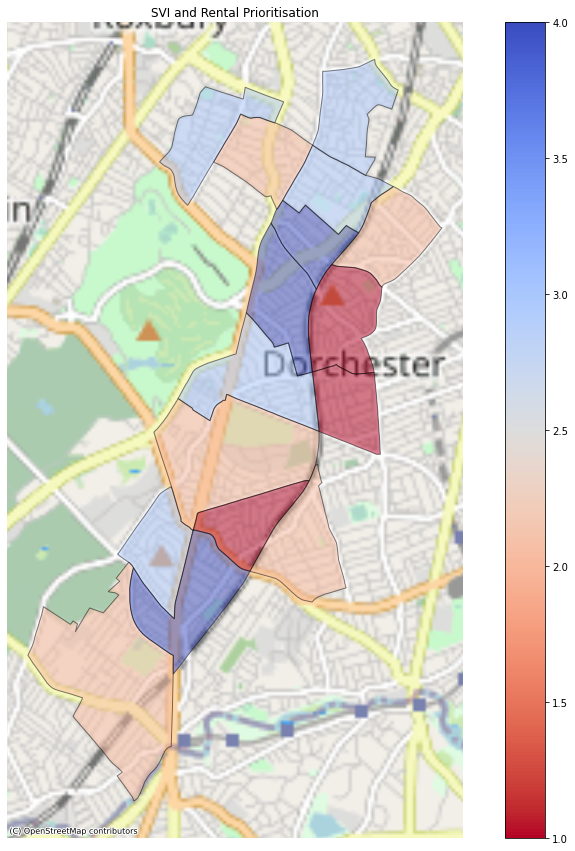

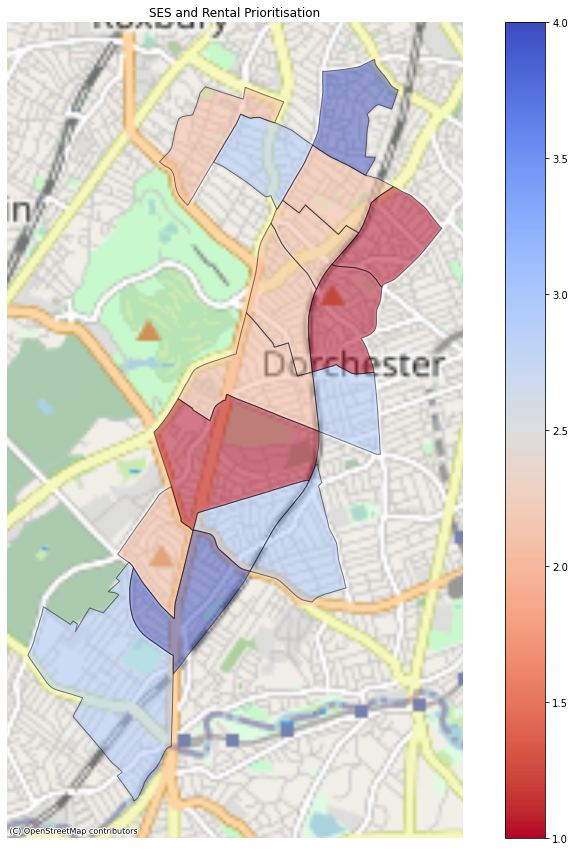

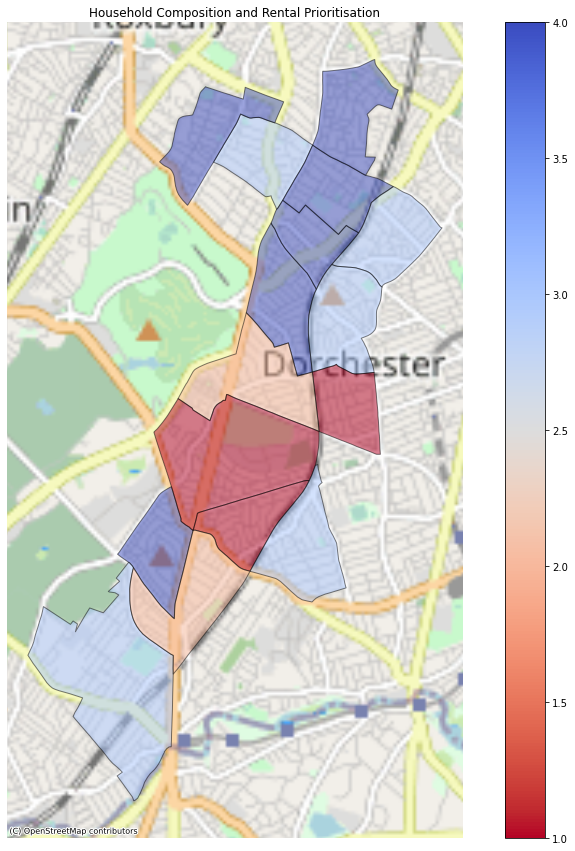

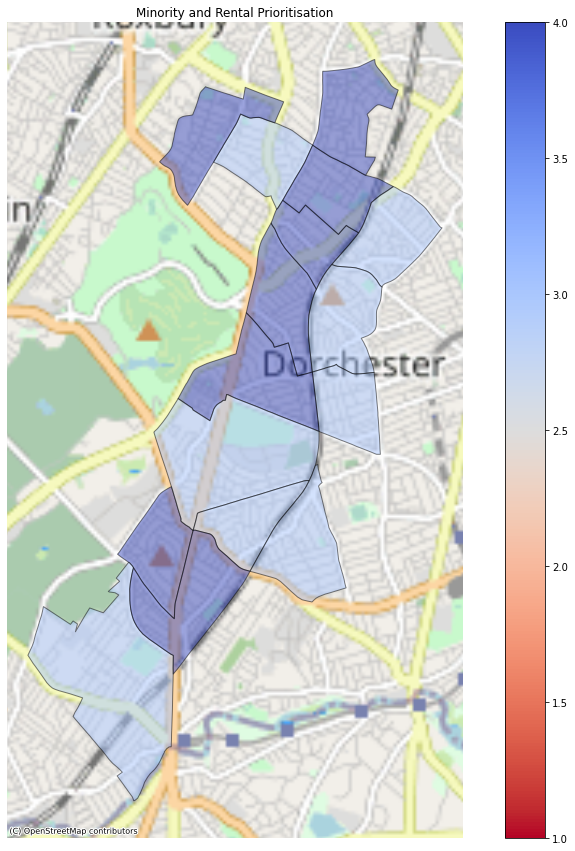

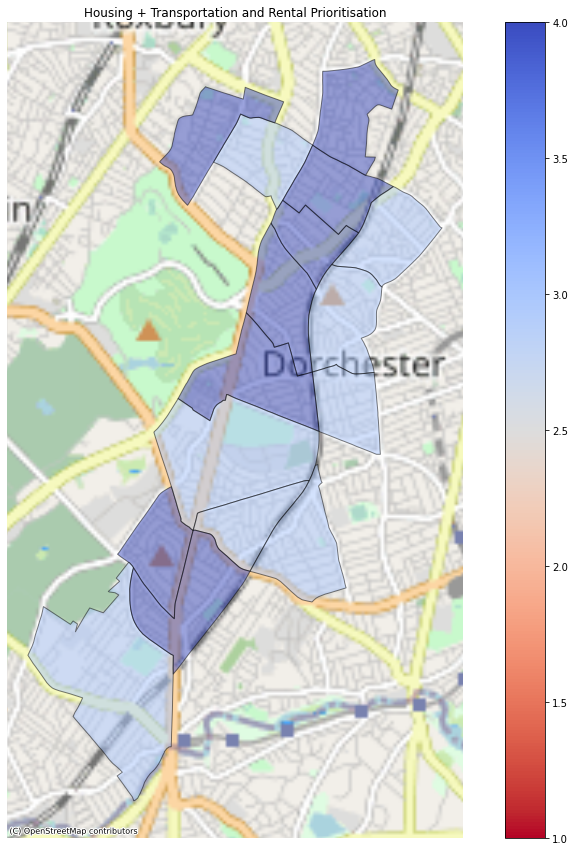

In [ ]:
#1 = (HH), 2 = (HL), 3 = (LH), 4 = (LL) where HH = High SVI, High Redlining, LH = Low SVI, High Redline

import contextily as ctx

cluster_list = ['SVI_cluster','SVI_1_cluster','SVI_2_cluster','SVI_3_cluster','SVI_4_cluster']
for i,j in zip(cluster_list, sviname):
    ax = minority_svi_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "coolwarm_r",legend=True, vmin = 1, vmax = 4)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} and Rental Prioritisation'.format(j))
    ax.set_axis_off()

#### Correlations with Transport Access (Subway Stations)

In [ ]:
#Loading the data 
gdf_Boston.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'geo_id', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'poverty', 'unemployed_pop', 'median_income', 'income_per_capita',
       'less_than_high_school_graduate', 'aged_65_or_older',
       'aged_17_or_younger', 'one_parent_families_with_young_children',
       'non_white', 'multi_unit_structures', 'mobile_homes', 'no_cars',
       'group_quarters', 'pop_determined_poverty_status', 'total_pop',
       'households', 'housing_units', 'reweighted_redline_index',
       'ordinal_value'],
      dtype='object')

In [ ]:
## Creating SVI Variables 

svi_boston = gdf_Boston.copy()

#Creating SVI variables for all census tracts
svi_boston['poverty_perc'] = svi_boston['poverty']/svi_boston['pop_determined_poverty_status']
svi_boston['poverty_perc_bin'] = svi_boston['poverty_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['poverty_perc'] >= svi_boston['poverty_perc'].quantile(0.9), 'poverty_flag'] = 1
svi_boston['poverty_flag'] = svi_boston['poverty_flag'].fillna(0)

svi_boston['unemployed_pop_perc'] = svi_boston['unemployed_pop'] / svi_boston['total_pop']
svi_boston['unemployed_pop_perc_bin'] = svi_boston['unemployed_pop_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['unemployed_pop_perc'] >= svi_boston['unemployed_pop_perc'].quantile(0.9), 'unemployed_flag'] = 1
svi_boston['unemployed_flag'] = svi_boston['unemployed_flag'].fillna(0)

svi_boston['less_than_high_school_graduate_perc'] = svi_boston['less_than_high_school_graduate'] / svi_boston['total_pop']
svi_boston['less_than_high_school_graduate_perc_bin'] = svi_boston['less_than_high_school_graduate_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['less_than_high_school_graduate_perc'] >= svi_boston['less_than_high_school_graduate_perc'].quantile(0.9), 'less_than_high_school_graduate_flag'] = 1
svi_boston['less_than_high_school_graduate_flag'] = svi_boston['less_than_high_school_graduate_flag'].fillna(0)

svi_boston['aged_65_or_older_perc'] = svi_boston['aged_65_or_older'] / svi_boston['total_pop']
svi_boston['aged_65_or_older_perc_bin'] = svi_boston['aged_65_or_older_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['aged_65_or_older_perc'] >= svi_boston['aged_65_or_older_perc'].quantile(0.9), 'aged_65_or_older_flag'] = 1
svi_boston['aged_65_or_older_flag'] = svi_boston['aged_65_or_older_flag'].fillna(0)

svi_boston['aged_17_or_younger_perc'] = svi_boston['aged_17_or_younger'] / svi_boston['total_pop']
svi_boston['aged_17_or_younger_perc_bin'] = svi_boston['aged_17_or_younger_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['aged_17_or_younger_perc'] >= svi_boston['aged_17_or_younger_perc'].quantile(0.9), 'aged_17_or_younger_flag'] = 1
svi_boston['aged_17_or_younger_flag'] = svi_boston['aged_17_or_younger_flag'].fillna(0)

svi_boston['one_parent_families_with_young_children_perc'] = svi_boston['one_parent_families_with_young_children'] / svi_boston['households']
svi_boston['one_parent_families_with_young_children_perc_bin'] = svi_boston['one_parent_families_with_young_children_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['one_parent_families_with_young_children_perc'] >= svi_boston['one_parent_families_with_young_children_perc'].quantile(0.9), 'one_parent_families_with_young_children_flag'] = 1
svi_boston['one_parent_families_with_young_children_flag'] = svi_boston['one_parent_families_with_young_children_flag'].fillna(0)

svi_boston['multi_unit_structures_perc'] = svi_boston['multi_unit_structures'] / svi_boston['housing_units']
svi_boston['multi_unit_structures_perc_bin'] = svi_boston['multi_unit_structures_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['multi_unit_structures_perc'] >= svi_boston['multi_unit_structures_perc'].quantile(0.9), 'multi_unit_structures_flag'] = 1
svi_boston['multi_unit_structures_flag'] = svi_boston['multi_unit_structures_flag'].fillna(0)

svi_boston['mobile_homes_perc'] = svi_boston['mobile_homes'] / svi_boston['housing_units']
svi_boston['mobile_homes_perc_bin'] = svi_boston['mobile_homes_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['mobile_homes_perc'] >= svi_boston['mobile_homes_perc'].quantile(0.9), 'mobile_homes_flag'] = 1
svi_boston['mobile_homes_flag'] = svi_boston['mobile_homes_flag'].fillna(0)

svi_boston['no_cars_perc'] = svi_boston['no_cars'] / svi_boston['households']
svi_boston['no_cars_perc_bin'] = svi_boston['no_cars_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['no_cars_perc'] >= svi_boston['no_cars_perc'].quantile(0.9), 'no_cars_flag'] = 1
svi_boston['no_cars_flag'] = svi_boston['no_cars_flag'].fillna(0)

svi_boston['group_quarters_perc'] = svi_boston['group_quarters'] / svi_boston['total_pop']
svi_boston['group_quarters_perc_bin'] = svi_boston['group_quarters_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['group_quarters_perc'] >= svi_boston['group_quarters_perc'].quantile(0.9), 'group_quarters_flag'] = 1
svi_boston['group_quarters_flag'] = svi_boston['group_quarters_flag'].fillna(0)

In [ ]:
# Setting flags for the tracts which are ranked at 90th percentile and above

svi_boston.loc[svi_boston['median_income'] <= svi_boston['median_income'].quantile(0.1), 'median_income_flag'] = 1
svi_boston['median_income_flag'] = svi_boston['median_income_flag'].fillna(0)

svi_boston.loc[svi_boston['income_per_capita'] <= svi_boston['income_per_capita'].quantile(0.1), 'income_per_capita_flag'] = 1
svi_boston['income_per_capita_flag'] = svi_boston['income_per_capita_flag'].fillna(0)

In [ ]:
#Minority Flag
svi_boston['non_white_perc'] = svi_boston['non_white'] / svi_boston['total_pop']
svi_boston['non_white_perc_bin'] = svi_boston['non_white_perc'].apply(perc_bin)
svi_boston.loc[svi_boston['non_white_perc'] >= svi_boston['non_white_perc'].quantile(0.7), 'non_white_flag'] = 1
svi_boston['non_white_flag'] = svi_boston['non_white_flag'].fillna(0)


# The number of flags (for each tract), all SVI-based variables
svi_boston['SVI'] = svi_boston['poverty_flag'] + svi_boston['unemployed_flag'] + svi_boston['median_income_flag'] + svi_boston['income_per_capita_flag'] + svi_boston['less_than_high_school_graduate_flag'] + svi_boston['aged_65_or_older_flag'] + svi_boston['aged_17_or_younger_flag'] + svi_boston['one_parent_families_with_young_children_flag'] + svi_boston['non_white_flag'] + svi_boston['multi_unit_structures_flag'] + svi_boston['mobile_homes_flag'] + svi_boston['no_cars_flag'] + svi_boston['group_quarters_flag']

# The number of flags (for each tract); Theme#1: Socioeconomic Status
svi_boston['SVI_1'] = svi_boston['poverty_flag'] + svi_boston['unemployed_flag'] + svi_boston['median_income_flag'] + svi_boston['income_per_capita_flag'] + svi_boston['less_than_high_school_graduate_flag']

# The number of flags (for each tract); Theme#2: Household Composition & Disability
svi_boston['SVI_2'] = svi_boston['aged_65_or_older_flag'] + svi_boston['aged_17_or_younger_flag'] + svi_boston['one_parent_families_with_young_children_flag']

# The number of flags (for each tract); Theme#3: Minority Status & Language
svi_boston['SVI_3'] = svi_boston['non_white_flag']

# The number of flags (for each tract); Theme#4: Housing Type & Transportation
svi_boston['SVI_4'] = svi_boston['multi_unit_structures_flag'] + svi_boston['mobile_homes_flag'] + svi_boston['no_cars_flag'] + svi_boston['group_quarters_flag']

In [ ]:
svi_boston.shape

(196, 72)

In [ ]:
#Loading Subway Map
boston_stations = gpd.read_file('/work/COVIDRedlining/data/boston/boston_stations.geojson')
boston_stations.head()

,Name,description,timestamp,begin,end,altitudeMode,tessellate,extrude,visibility,drawOrder,icon,snippet,geometry
0,Alewife Station,\nhttp://mbta.com/schedules_and_maps/subway/li...,None,None,None,None,-1,0,-1,None,None,,POINT Z (-71.14098 42.39491 0.00000)
1,Davis Station,\nhttp://mbta.com/schedules_and_maps/subway/li...,None,None,None,None,-1,0,-1,None,None,,POINT Z (-71.12206 42.39606 0.00000)
2,Porter Square Station,\nhttp://mbta.com/schedules_and_maps/subway/li...,None,None,None,None,-1,0,-1,None,None,,POINT Z (-71.11924 42.38835 0.00000)
3,Harvard Square Station,\nhttp://mbta.com/schedules_and_maps/subway/li...,None,None,None,None,-1,0,-1,None,None,,POINT Z (-71.11911 42.37394 0.00000)
4,Central Station,\nhttp://mbta.com/schedules_and_maps/subway/li...,None,None,None,None,-1,0,-1,None,None,,POINT Z (-71.10332 42.36516 0.00000)


In [ ]:
#Separating lat-long
boston_stations['lon'] = boston_stations.geometry.apply(lambda x: x.x)
boston_stations['lat'] = boston_stations.geometry.apply(lambda x: x.y)

In [ ]:
#Creating rtree indexes for spatial matching of stations and census tracts
index = rtree.Rtree()
for idx,geometry in enumerate(svi_boston.geometry):
  index.insert(idx, geometry.bounds)

In [ ]:
#Spatial matching of incidents and Admin Wards

import csv
import pyproj
import shapely.geometry as geom

proj = pyproj.Proj(init="epsg:4326", preserve_units=True)    

counts = {}

for i, row in boston_stations.iterrows():
  p = geom.Point(proj(float(row['lon']), float(row['lat'])))
  match = None
  for idx in index.intersection((p.x, p.y, p.x, p.y)):
    if svi_boston.geometry[idx].contains(p):
      license = row['Name']
      match = svi_boston.geo_id[idx]
      counts[license] = match

/home/jovyan/venv/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
/home/jovyan/venv/lib/python3.7/site-packages/pyproj/crs/crs.py:294: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  projstring = _prepare_from_string(" ".join((projstring, projkwargs)))


In [ ]:
#Creating Dataframe with matched tracts to each station
geotags = pd.DataFrame(counts.items())
geotags = geotags.rename(columns={0:'station_name',1:'geo_id'})
geotags.head()

,station_name,geo_id
0,Charles/Massachusetts General Hospital Station,2.502502e+10
1,Park Street Station,2.502507e+10
2,Downtown Crossing Station,2.502507e+10
3,South Station,2.502507e+10
4,Broadway Station,2.502506e+10


In [ ]:
#Grouping incidents by locations and getting top 20 wards with most reported cases
station_counts = pd.DataFrame(geotags.groupby('geo_id').agg('count'))
station_counts.head()

,station_name
geo_id,
2.502140e+10,4
2.502140e+10,1
2.502140e+10,6
2.502140e+10,4
2.502142e+10,4


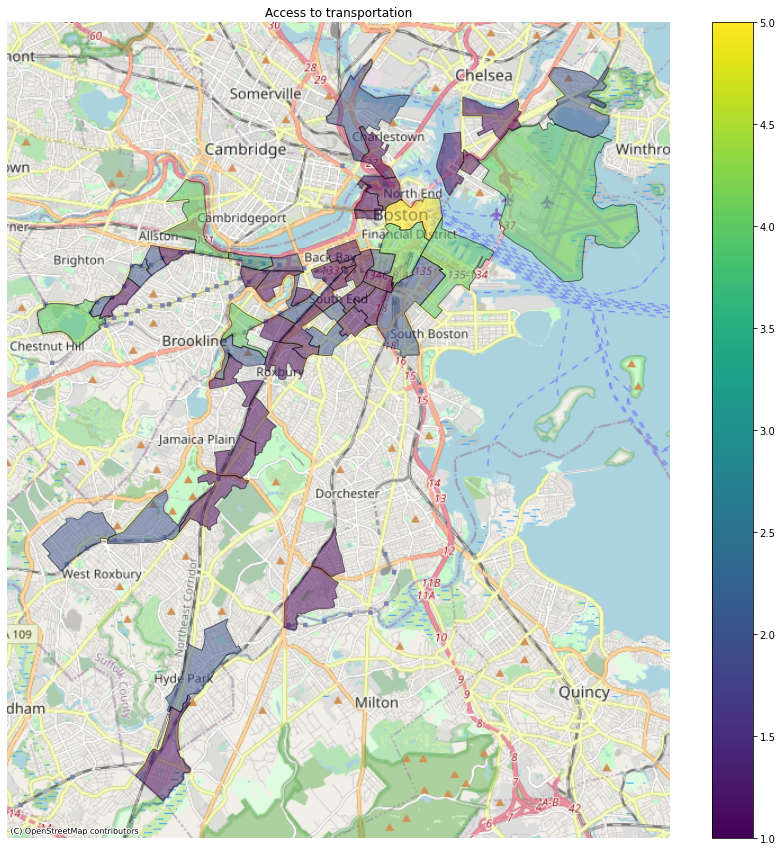

In [ ]:
#Mapping Stations Across Boston
ax = svi_boston.to_crs('EPSG:3857').plot(column='station_counts',figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "viridis",legend=True)
ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title('Access to transportation')
ax.set_axis_off()

In [ ]:
#Merging 
svi_boston = svi_boston.merge(station_counts,on='geo_id',how='left')
svi_boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,income_per_capita_flag,non_white_perc,non_white_perc_bin,non_white_flag,SVI,SVI_1,SVI_2,SVI_3,SVI_4,station_name
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,0.0,0.312560,4,0.0,2.0,0.0,1.0,0.0,1.0,1.0
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,0.0,0.615903,7,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,0.0,0.203986,3,0.0,0.0,0.0,0.0,0.0,0.0,NaN
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,0.0,0.663838,7,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,0.0,0.954957,10,1.0,2.0,1.0,0.0,1.0,0.0,NaN


In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SVI','SES','Household_Composition','Minority','Housing_Transportation'])

#Dropping null values
svi_boston = svi_boston.dropna()

#Renaming columns 
svi_boston = svi_boston.rename(columns={'station_name':'station_counts'})

#Getting all SVI columns
SVI_corr_vars = ['SVI','SVI_1','SVI_2','SVI_3','SVI_4']

t = [25025091400.0,25025092200.0,25025100800.0,25025091001.0]
svi_boston = svi_boston.loc[~svi_boston.geo_id.isin(t)]

#Spatial transformations
w = Queen.from_dataframe(svi_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SVI_corr_vars:
#Running spatial correlations
    y = svi_boston[i].values
    x = svi_boston['station_counts'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    #plot_local_autocorrelation(moran_loc_bv, svi_boston, 'SVI', figsize=(15,15))
    #Adding a column for cluster values
    #svi_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    #plt.title('{} and Transport Access'.format(i), fontdict={'fontsize':20})
    #plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
  warnings.warn(message)


In [ ]:
spatial_corr

,SVI,SES,Household_Composition,Minority,Housing_Transportation
0,0.053753,-0.020987,-0.050916,0.019412,0.139668


<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=c9a4f701-31a5-4164-b3f3-c09cddf1309e' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>